In [1]:
import os
import matplotlib.pyplot as plt
import numpy as np
#import tensorflow as tf
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import load_model

# import required libraries
import cv2
import os

In [4]:
ndir = "C:/Users/research/Desktop/thesis2/cap_face"
nmane = ndir + '/' + 'nowface.jpg'

# read the haarcascade to detect the faces in an image
face_cascade2 = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')
face_cascade1 = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt2.xml')
face_cascade3 = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_default.xml')
face_cascade4 = cv2.CascadeClassifier('haarcascades/haarcascade_profileface.xml')

cap = cv2.VideoCapture(0)



while(True):
    #capture frame by frame
    ret, frame = cap.read()
    
    # convert to grayscale of each frames
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    # detects faces in the input image
    faces = face_cascade1.detectMultiScale(gray, 1.1, 2)
    #if len(faces) == 0:
        #faces = face_cascade2.detectMultiScale(gray, 1.1, 2)
    #if len(faces) == 0:
        #faces = face_cascade3.detectMultiScale(gray, 1.1, 2)
    #if len(faces) == 0:
        #faces = face_cascade4.detectMultiScale(gray, 1.1, 2)
        
    if len(faces) > 0:
        for i, (x, y, w, h) in enumerate(faces):
            # To draw a rectangle in a face
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 255), 2)
            face = frame[y:y + h, x:x + w]
            #cv2.imshow("Cropped Face", face)
            face = cv2.resize(face, (224, 224))
            cv2.imwrite(f'{nmane}', face)
            print(f"{nmane} is saved")
            
            #load model
            new_modelp = load_model('my_mthesis_model_31ep.h5')
            model = 'my_mthesis_model_31ep.h5'
            img1 = cv2.imread(nmane)
            #plt.imshow(img1)
            final_img = cv2.resize(img1, (224, 224))
            final_img = np.expand_dims(final_img,axis =0) #adding fourth dimension
            final_img = final_img/255.0 #normalizing
            Predictions = new_modelp.predict(final_img)
            model_pic_predict = np.argmax(Predictions)
            print(model_pic_predict)
            
            font = cv2.FONT_HERSHEY_SIMPLEX
            name = str(model_pic_predict)
            color = (255,255,255)
            stroke = 2
            cv2.putText(frame, name, (x,y), font, 1, color, stroke, cv2.LINE_AA)
        
        #Display the resulting frame
        cv2.imshow('frame', frame)
        if cv2.waitKey(20) & 0xFF == ord('q'):
            break
            
cap.release()
cv2.destroyAllWindows()
        
            
            
            

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
3
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
3
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
8
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
5
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
5
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
3
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
3
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
5
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
3
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
3
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
8
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
8
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
3
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
8
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
3
C:/Users/r

KeyboardInterrupt: 

In [2]:
ndir = "C:/Users/research/Desktop/thesis2/cap_face"
nmane = ndir + '/' + 'nowface.png'

imgitem = 'nowface.png'

# read the haarcascade to detect the faces in an image
#face_cascade2 = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')
face_cascade1 = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt2.xml')
#face_cascade3 = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_default.xml')
#face_cascade4 = cv2.CascadeClassifier('haarcascades/haarcascade_profileface.xml')

cap = cv2.VideoCapture(0)

new_modelp = load_model('my_mthesis_model_31ep.h5')

while(True):
    #capture frame by frame
    ret, frame = cap.read()
    
    # convert to grayscale of each frames
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    # detects faces in the input image
    faces = face_cascade1.detectMultiScale(gray, 1.1, 2)
    #if len(faces) == 0:
        #faces = face_cascade2.detectMultiScale(gray, 1.1, 2)
    #if len(faces) == 0:
        #faces = face_cascade3.detectMultiScale(gray, 1.1, 2)
    #if len(faces) == 0:
        #faces = face_cascade4.detectMultiScale(gray, 1.1, 2)
        
    for (x, y, w, h) in faces:
        print(x, y, w, h)
        roi_gray = gray[y:y+h, x:x+w]
        #roi_color = frame[y:y+h, x:x+w]
        cv2.imwrite(imgitem, roi_gray)
        
        # To draw a rectangle in a face
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 255), 2)
        
        #load model
        
        model = 'my_mthesis_model_31ep.h5'
        img1 = cv2.imread(imgitem)
        #plt.imshow(img1)
        final_img = cv2.resize(img1, (224, 224))
        final_img = np.expand_dims(final_img,axis =0) #adding fourth dimension
        final_img = final_img/255.0 #normalizing
        Predictions = new_modelp.predict(final_img)
        model_pic_predict = np.argmax(Predictions)
        print(model_pic_predict)
            
        font = cv2.FONT_HERSHEY_SIMPLEX
        name = str(model_pic_predict)
        color = (255,255,255)
        stroke = 2
        cv2.putText(frame, name, (x,y), font, 1, color, stroke, cv2.LINE_AA)
        
        
        
    #Display the resulting frame
    cv2.imshow('frame', frame)
    if cv2.waitKey(20) & 0xFF == ord('q'):
        break
        
            
            
         
cap.release()
cv2.destroyAllWindows()
        
            

281 173 174 174
5
395 150 148 148
8
355 151 171 171
8
327 143 198 198
5
318 156 181 181
5
316 154 182 182
3
311 149 191 191
3
311 153 192 192
0
300 143 210 210
8
297 143 210 210
3
319 165 168 168
8
319 168 168 168
8
312 218 47 47
8
319 158 180 180
8
321 164 175 175
8
320 158 176 176
8
315 153 184 184
3
319 159 177 177
8
317 158 182 182
8
318 158 180 180
8
315 214 49 49
8
318 157 180 180
8
310 163 185 185
8
359 259 122 122
8
310 168 184 184
2
311 170 186 186
8
314 172 184 184
8
319 179 171 171
8
315 172 182 182
8
317 174 180 180
8
322 176 176 176
8
311 168 191 191
8
315 172 180 180
8
317 174 185 185
8
304 150 198 198
8
442 385 47 47
8
443 386 46 46
8
447 389 43 43
8
447 385 44 44
8
443 384 47 47
8
452 388 42 42
8
454 386 43 43
8
316 83 204 204
8
316 84 203 203
8
451 383 44 44
8
451 383 46 46
8
451 383 46 46
8
291 107 198 198
8
453 381 46 46
8
452 383 47 47
8
447 383 44 44
8
450 387 43 43
8
446 383 49 49
8
449 385 44 44
8
452 388 42 42
8
451 388 44 44
8
306 230 135 135
8
279 131 197 197


2
320 263 132 132
2
324 264 128 128
2
323 265 127 127
8
320 264 131 131
1
324 264 131 131
2
324 265 127 127
2
322 263 130 130
8
324 264 128 128
2
323 265 122 122
1
322 262 126 126
2
314 262 138 138
2
325 272 130 130
2
323 280 118 118
8
331 280 123 123
8
326 279 126 126
8
326 279 126 126
8
326 279 126 126
8
326 279 126 126
8
312 275 140 140
2
317 278 139 139
8
316 274 138 138
8
317 274 138 138
8
317 273 139 139
8
317 272 139 139
8
318 271 140 140
2
326 277 131 131
8
322 271 138 138
8
327 270 138 138
2
341 281 127 127
2
338 279 130 130
2
346 279 124 124
2
350 273 122 122
0
352 279 115 115
0
352 283 114 114
2
347 282 117 117
5
350 281 119 119
2
345 282 120 120
2
345 286 114 114
2
341 284 122 122
2
343 286 119 119
2
340 284 125 125
2
342 287 120 120
2
341 286 121 121
2
343 287 121 121
2
341 288 123 123
2
344 288 120 120
2
337 283 132 132
2
341 287 123 123
2
342 288 121 121
2
342 288 121 121
2
342 288 122 122
5
340 286 126 126
2
344 290 120 120
2
342 288 123 123
2
340 287 125 125
2
344 289 

KeyboardInterrupt: 

a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.35241745e-04 2.16150433e-02 5.79825777e-04 1.00186386e-04
 8.55307910e-04 7.37490728e-02 4.48623160e-03 8.89910340e-01
 7.96870608e-03]
The he predicted facial expression is 7


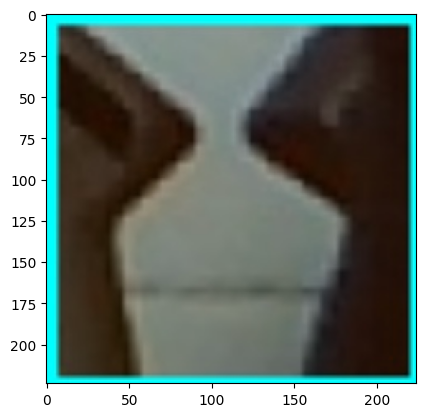

a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number o

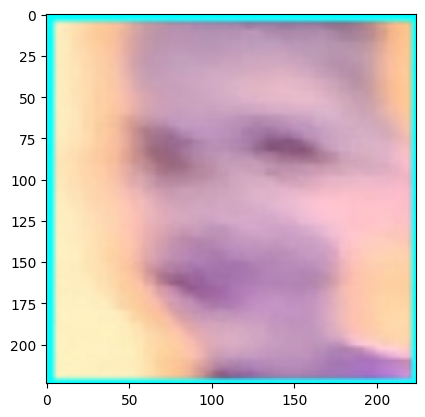

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[0.02542867 0.05844739 0.0383647  0.19601083 0.17409831 0.11870522
 0.15083547 0.19552983 0.04257959]
The he predicted facial expression is 3


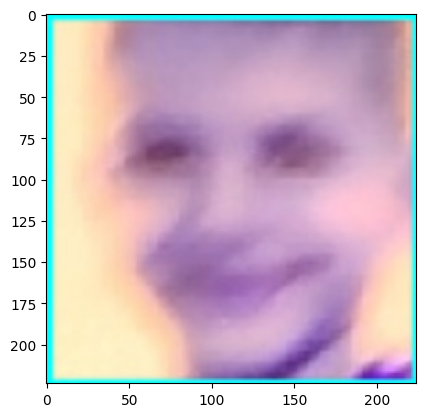

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[0.00223839 0.00694787 0.0019661  0.04528369 0.00937442 0.0015049
 0.00885915 0.12547216 0.7983533 ]
The he predicted facial expression is 8


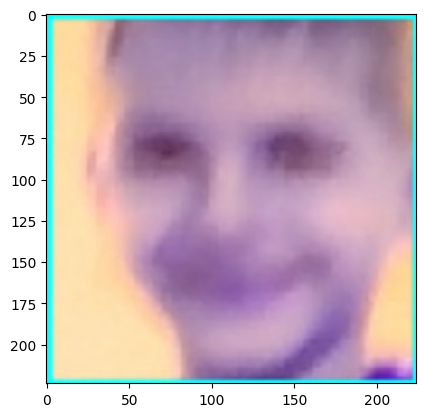

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[0.00080058 0.10126485 0.00882219 0.00266782 0.07126192 0.02537092
 0.02584277 0.75710034 0.00686859]
The he predicted facial expression is 7


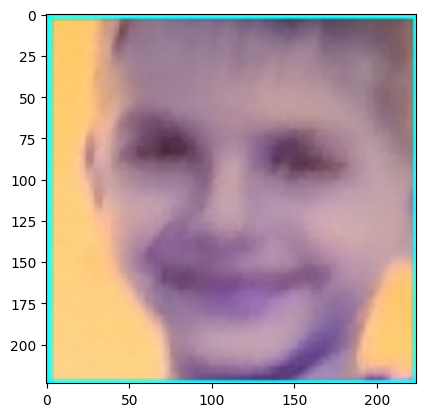

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[8.3414722e-07 2.9585292e-03 1.0668144e-04 1.0821703e-06 5.2086601e-04
 3.8565187e-05 4.8446927e-05 9.9461281e-01 1.7122636e-03]
The he predicted facial expression is 7


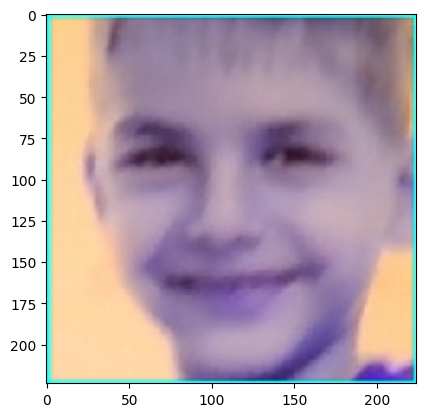

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[5.2306573e-06 9.4660211e-01 9.5303141e-05 1.8044113e-06 4.1736171e-02
 7.2481656e-05 5.0764279e-03 6.3999193e-03 1.0580143e-05]
The he predicted facial expression is 1


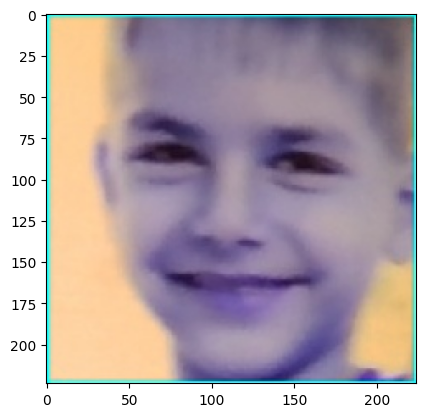

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.3534877e-05 8.9583713e-01 3.5994078e-04 1.7524164e-05 5.7176288e-02
 2.7817239e-03 1.4547653e-02 2.9228305e-02 7.8214307e-06]
The he predicted facial expression is 1


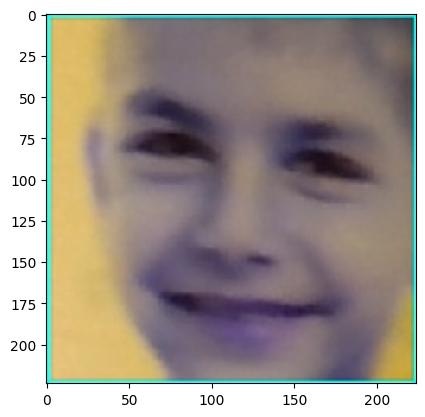

a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.3773157e-05 9.9314755e-01 5.4349977e-04 1.1294370e-03 9.7647629e-05
 2.7252678e-03 2.2468553e-03 4.5952002e-05 1.1763676e-08]
The he predicted facial expression is 1


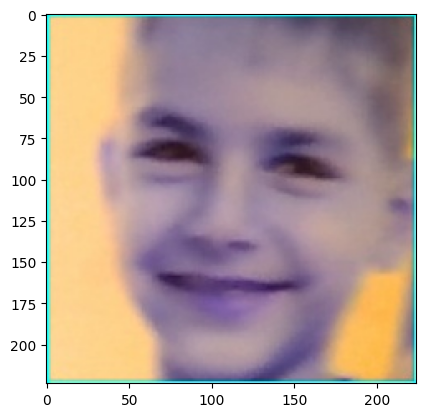

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.1214168e-04 7.8003502e-01 2.3481695e-03 1.5052782e-04 9.7380646e-02
 2.1408005e-03 1.9739380e-02 9.7697139e-02 3.9619411e-04]
The he predicted facial expression is 1


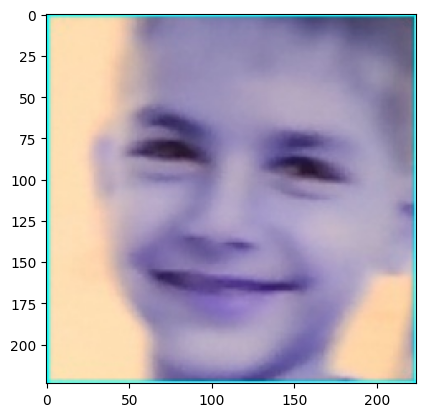

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.1497867e-07 9.9745780e-01 5.4681504e-07 2.3590101e-09 1.5192931e-03
 7.0892543e-07 6.7958294e-04 3.4169148e-04 1.4694831e-07]
The he predicted facial expression is 1


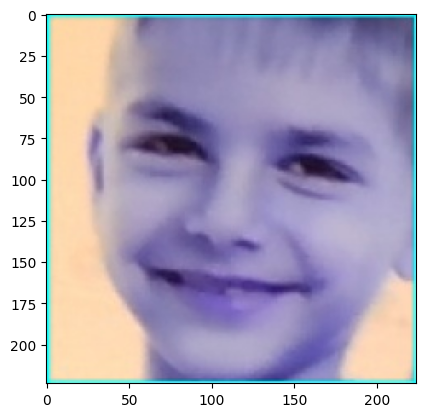

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[9.5898713e-08 9.9979204e-01 6.4490777e-08 3.3997847e-09 1.5376207e-05
 5.8516957e-07 1.9163181e-04 2.0335222e-07 1.3505506e-11]
The he predicted facial expression is 1


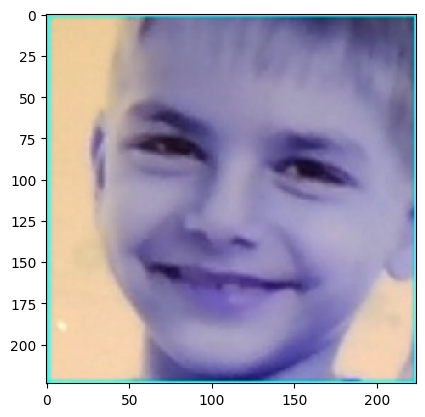

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.4945888e-07 9.9607652e-01 1.4869751e-05 1.6649489e-07 2.2213964e-03
 9.4762845e-06 6.8051944e-04 9.9608081e-04 2.7037495e-07]
The he predicted facial expression is 1


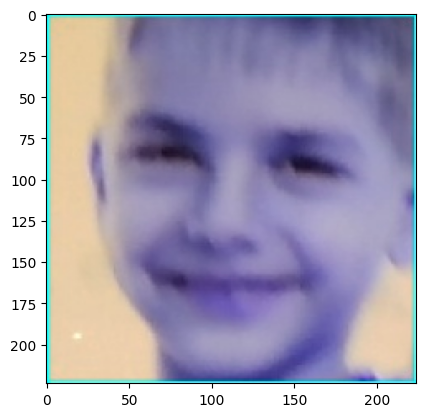

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.5928417e-07 9.9994886e-01 3.0099960e-07 9.9402428e-07 2.8995895e-09
 1.0705925e-05 3.9011695e-05 9.7374060e-11 6.3192178e-16]
The he predicted facial expression is 1


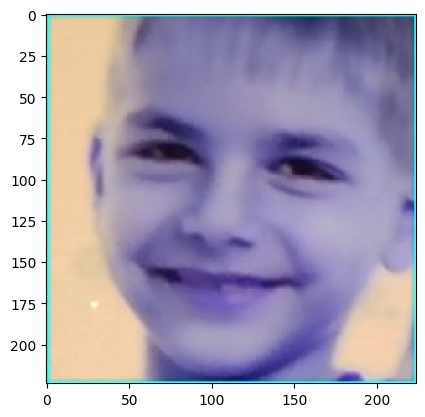

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.6105674e-06 9.9499029e-01 6.3681677e-05 1.3741710e-06 2.8139560e-03
 3.9657622e-05 1.6073466e-03 4.8040351e-04 6.8600616e-07]
The he predicted facial expression is 1


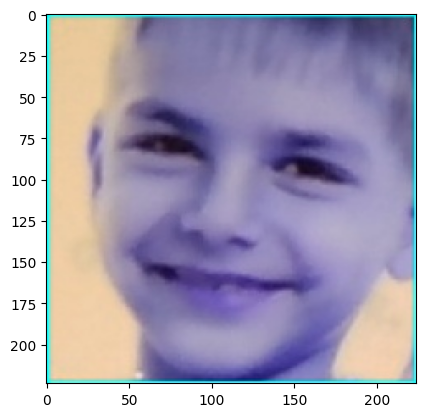

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.0997361e-06 9.9746144e-01 4.7664248e-06 2.3459729e-07 5.5213243e-04
 2.0089379e-05 1.9328836e-03 2.4411089e-05 1.6832903e-08]
The he predicted facial expression is 1


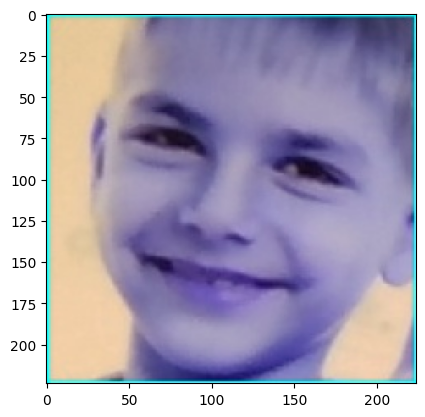

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.1864055e-04 9.7719961e-01 2.1360330e-04 1.3150653e-05 7.8050219e-03
 5.8130414e-04 1.2542334e-02 1.5200523e-03 6.3127973e-06]
The he predicted facial expression is 1


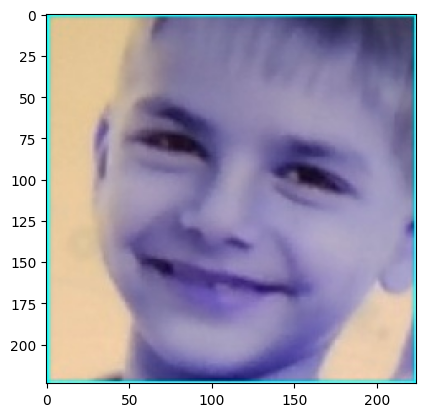

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.5913634e-04 9.8405021e-01 6.8606011e-04 2.4469984e-03 3.4259749e-05
 6.3624517e-03 6.1510089e-03 9.8267101e-06 5.0030331e-09]
The he predicted facial expression is 1


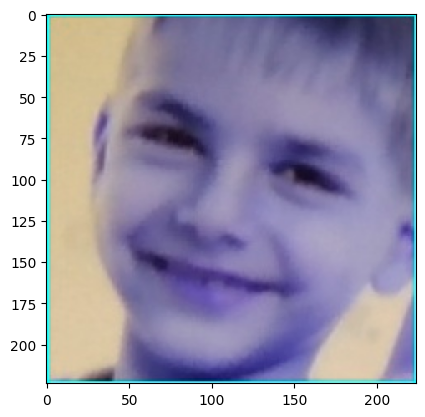

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.4264424e-06 9.8920780e-01 3.4388446e-05 4.0204890e-07 6.3836332e-03
 1.9578329e-05 1.2400720e-03 3.1108733e-03 1.8032781e-06]
The he predicted facial expression is 1


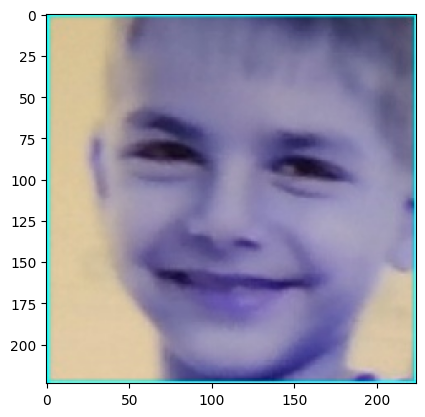

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.12330945e-07 9.99806702e-01 9.19161209e-08 3.00381342e-09
 2.62136764e-05 7.01959323e-07 1.65075893e-04 1.08510062e-06
 3.14377795e-11]
The he predicted facial expression is 1


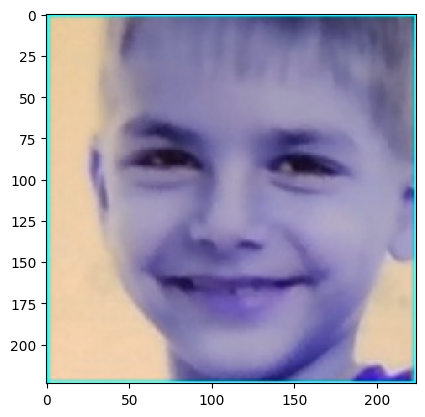

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.5298034e-05 2.8167630e-03 3.5393416e-05 1.3683580e-06 8.7558372e-05
 3.2935000e-03 2.3244566e-04 9.9065000e-01 2.8577652e-03]
The he predicted facial expression is 7


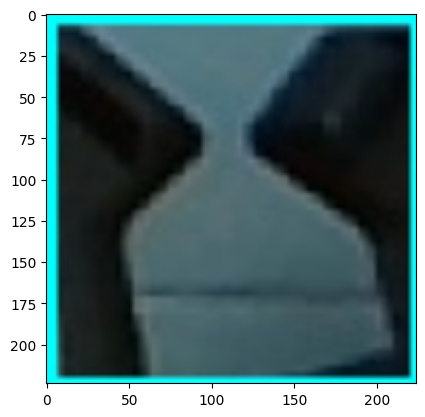

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.0067726e-06 1.2357879e-01 3.9258564e-05 2.0667063e-07 1.4396257e-02
 8.4980325e-05 1.6100010e-03 8.5963118e-01 6.5232912e-04]
The he predicted facial expression is 7


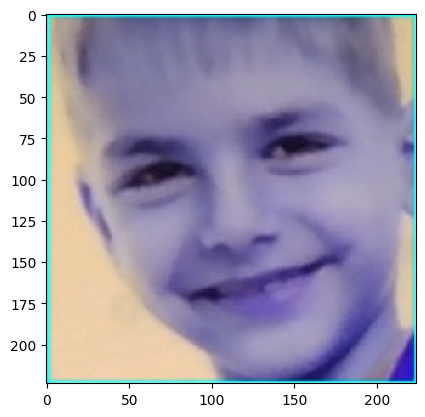

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.4322345e-07 6.5531568e-03 1.9622353e-06 6.1758074e-09 1.2624965e-03
 2.7944416e-06 6.6982167e-05 9.9166906e-01 4.4325806e-04]
The he predicted facial expression is 7


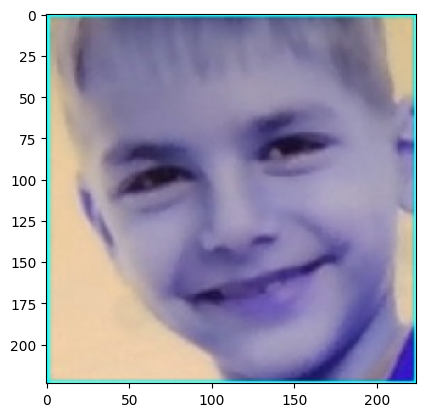

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.2709714e-07 3.1392612e-03 1.6401159e-06 9.4255359e-09 7.6466065e-04
 2.9229809e-06 5.2758940e-05 9.9525428e-01 7.8422565e-04]
The he predicted facial expression is 7


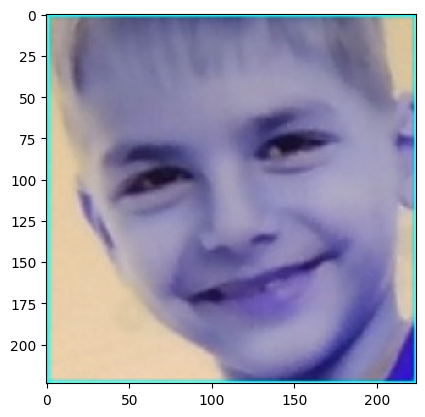

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[0.03949278 0.03425337 0.07102308 0.18046896 0.04049747 0.08234563
 0.05701808 0.30459976 0.19030088]
The he predicted facial expression is 7


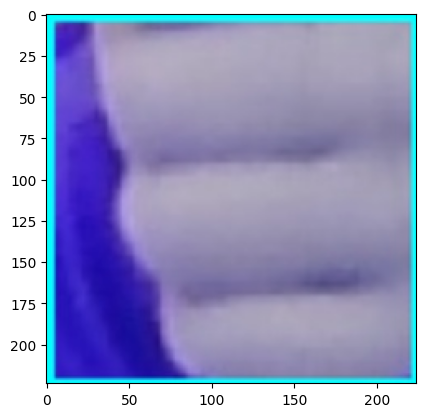

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.3029923e-07 4.5866735e-02 5.0065582e-06 4.4194750e-09 2.1961264e-02
 3.4368347e-06 4.3601816e-04 9.3135136e-01 3.7597350e-04]
The he predicted facial expression is 7


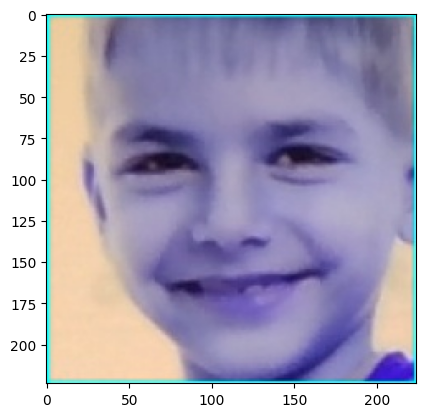

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.6840132e-06 9.9125904e-01 4.8965903e-06 2.9841047e-08 4.4308915e-03
 8.4717149e-06 1.8854684e-03 2.4077452e-03 7.4101655e-07]
The he predicted facial expression is 1


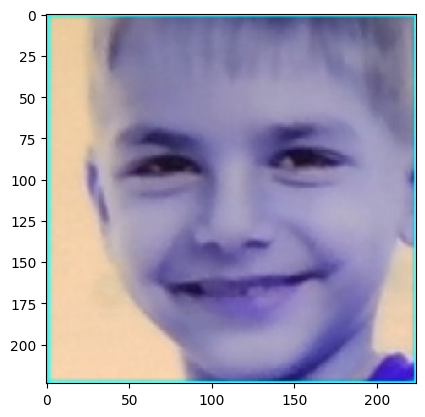

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.0069572e-06 6.7648631e-05 2.6159148e-06 9.3289373e-06 1.4423724e-06
 1.8791034e-04 1.3514701e-05 9.9641716e-01 3.2963054e-03]
The he predicted facial expression is 7


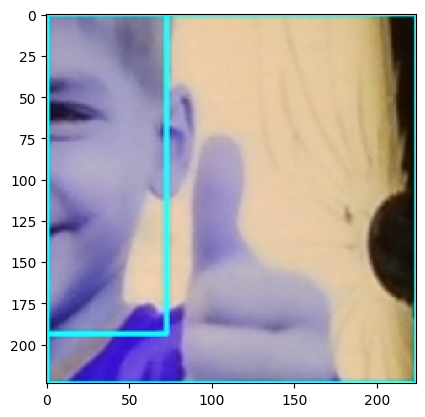

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[9.7691846e-08 9.9711955e-01 2.3017972e-07 4.1405704e-10 1.8650304e-03
 3.5247348e-07 3.8960474e-04 6.2509131e-04 3.3813343e-08]
The he predicted facial expression is 1


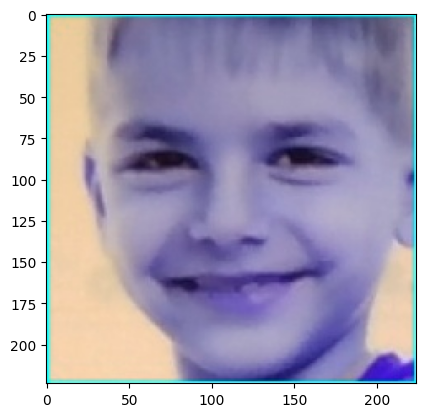

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.00079614e-06 9.97150600e-01 3.67583880e-06 9.62237579e-08
 1.07158697e-03 1.04456585e-05 1.56448968e-03 1.95977627e-04
 6.73202010e-08]
The he predicted facial expression is 1


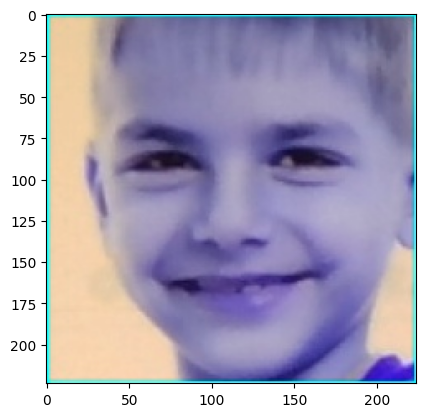

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.2244464e-06 9.9962342e-01 7.7968843e-06 9.2327355e-06 6.4103133e-06
 4.9783528e-05 3.0195052e-04 1.6280255e-07 1.6790782e-11]
The he predicted facial expression is 1


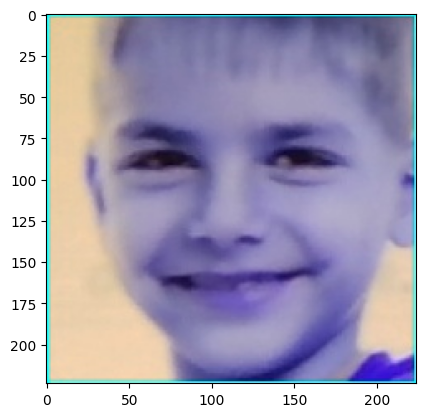

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.90541534e-05 1.24316085e-02 5.45467556e-05 1.84718397e-06
 4.34777903e-04 9.02206544e-03 8.88697454e-04 9.74615455e-01
 2.50188704e-03]
The he predicted facial expression is 7


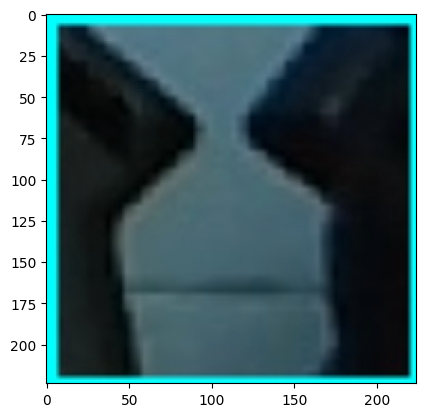

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.8825465e-07 9.9987984e-01 5.9735044e-07 3.9848243e-07 2.2687911e-06
 6.3876910e-06 1.1025941e-04 9.3649369e-08 3.6074752e-12]
The he predicted facial expression is 1


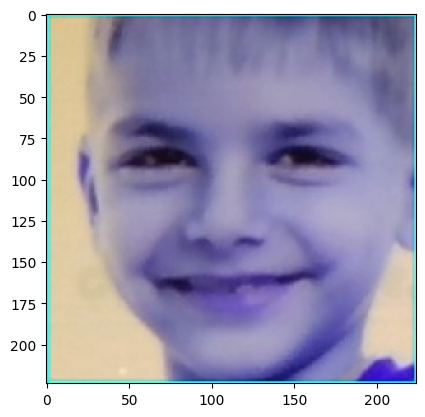

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.2430500e-04 2.6448363e-02 5.0832861e-04 1.9800380e-05 4.6069459e-03
 3.3679646e-02 5.1001683e-03 9.2285299e-01 6.4593591e-03]
The he predicted facial expression is 7


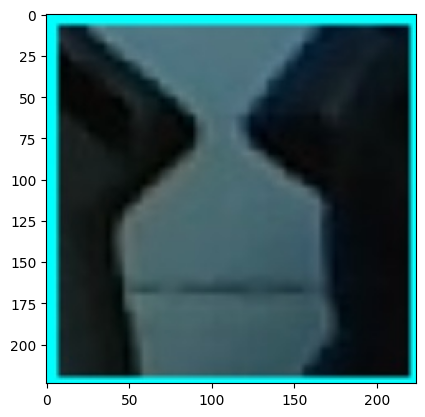

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.6819587e-07 9.9989200e-01 8.2188717e-07 8.6223929e-07 3.3516113e-07
 8.0885602e-06 9.7168646e-05 1.2541380e-08 5.2542958e-13]
The he predicted facial expression is 1


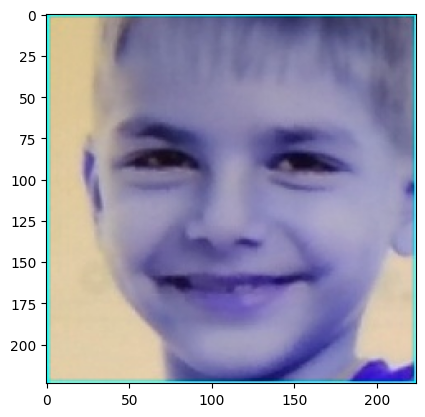

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.6029916e-05 5.8951918e-03 6.0509679e-05 2.2556828e-06 9.1202870e-05
 8.3964914e-03 3.3423133e-04 9.8269373e-01 2.4902916e-03]
The he predicted facial expression is 7


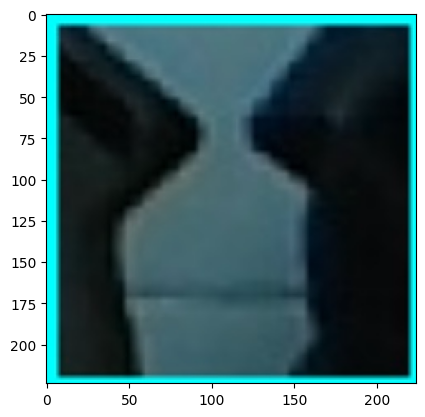

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.0655287e-07 9.9996567e-01 1.0439937e-06 2.6487339e-06 4.7935780e-09
 1.1184721e-05 1.9344901e-05 3.0705988e-10 1.5664718e-15]
The he predicted facial expression is 1


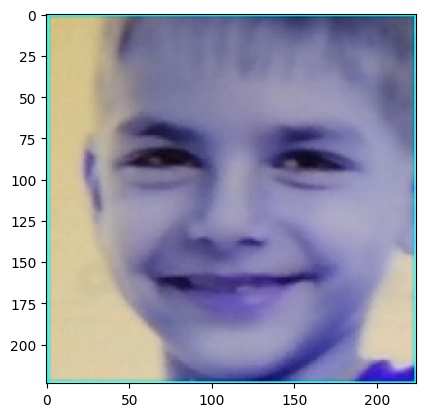

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.17830005e-07 9.99973774e-01 2.52618662e-07 5.28797102e-07
 5.63040592e-09 5.14789235e-06 2.00653449e-05 2.09014486e-10
 1.06406862e-15]
The he predicted facial expression is 1


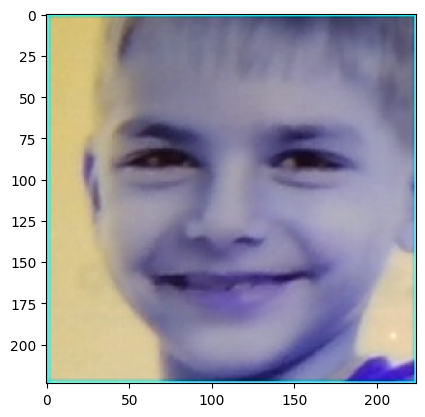

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[5.2947914e-08 2.4613058e-02 1.0499481e-06 5.4146854e-10 4.9359901e-03
 8.9612109e-07 9.9076125e-05 9.7022331e-01 1.2652442e-04]
The he predicted facial expression is 7


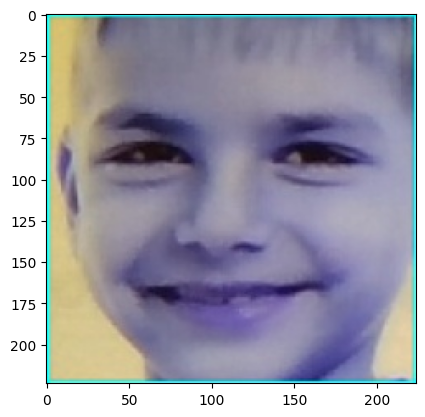

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.6706911e-05 9.9162591e-01 1.8251770e-04 1.6722557e-04 2.5808299e-07
 7.6168696e-03 3.5504391e-04 5.4200523e-06 3.6468581e-10]
The he predicted facial expression is 1


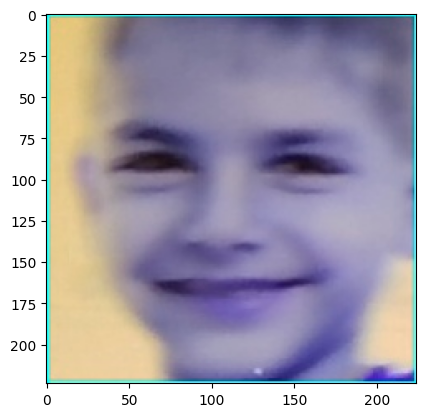

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.2004932e-05 2.1458720e-03 5.8802751e-05 1.8558065e-05 1.8987482e-04
 2.1699662e-03 3.7296492e-04 9.8241019e-01 1.2571737e-02]
The he predicted facial expression is 7


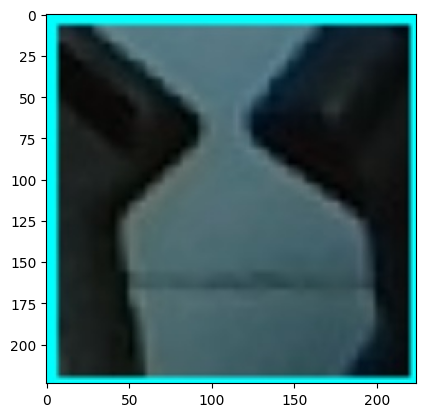

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.6073633e-02 4.3834800e-01 3.8305607e-01 1.0495575e-01 3.0314317e-05
 3.4794707e-02 1.4960651e-02 7.7265101e-03 5.4352000e-05]
The he predicted facial expression is 1


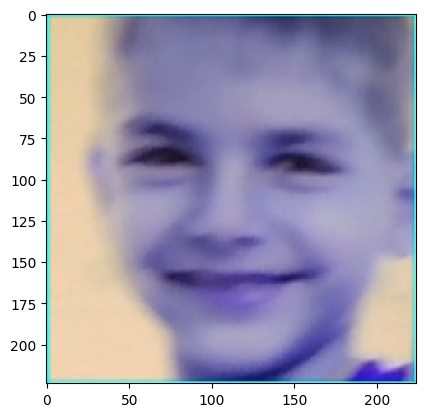

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[8.3541053e-08 9.9996960e-01 8.2296430e-07 1.7290137e-06 5.3769567e-09
 8.8121560e-06 1.8922876e-05 4.8294774e-10 3.8798221e-15]
The he predicted facial expression is 1


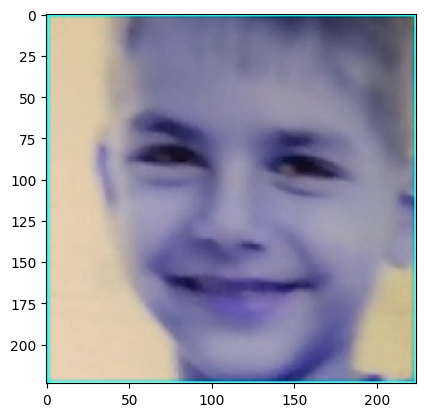

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.3931496e-07 9.9994576e-01 7.4867074e-08 3.0172814e-07 5.0699813e-09
 5.7878233e-06 4.7937487e-05 1.0361864e-10 5.5562450e-16]
The he predicted facial expression is 1


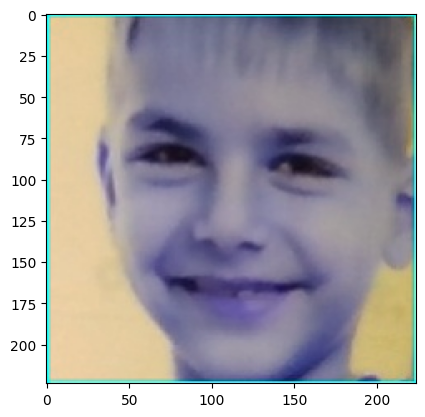

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.4200347e-07 9.9994636e-01 1.3646030e-07 4.5938012e-07 8.4523473e-09
 6.7444153e-06 4.6119352e-05 2.3338503e-10 1.6116591e-15]
The he predicted facial expression is 1


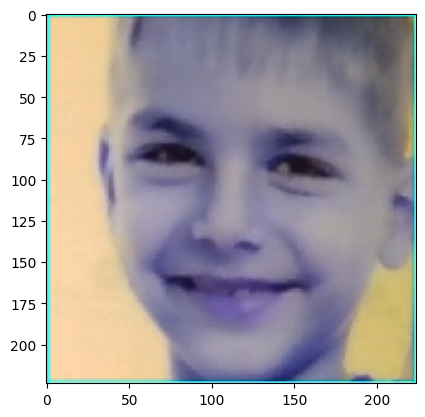

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.6978008e-06 9.9975008e-01 1.1032119e-05 6.1277801e-06 5.0291756e-06
 3.1543845e-05 1.9421606e-04 3.4262828e-07 5.4309179e-11]
The he predicted facial expression is 1


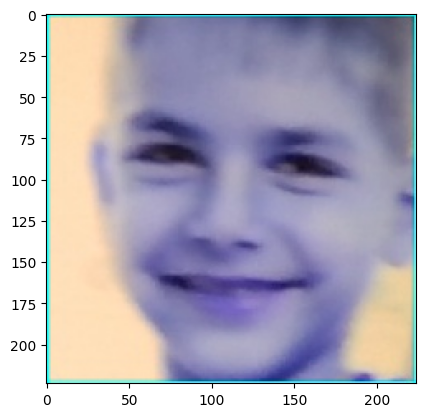

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.8584763e-05 9.9281222e-01 3.2156805e-04 8.8229892e-05 1.4808433e-03
 4.5508472e-04 4.6257228e-03 1.7717366e-04 4.4437434e-07]
The he predicted facial expression is 1


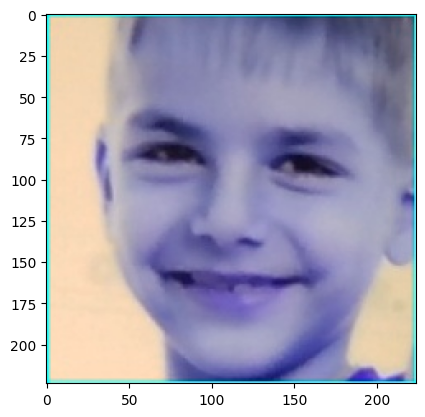

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.1085069e-06 9.9909425e-01 1.9577839e-05 7.3628503e-06 7.8173980e-05
 6.2908141e-05 7.3005381e-04 4.6038294e-06 1.4957031e-09]
The he predicted facial expression is 1


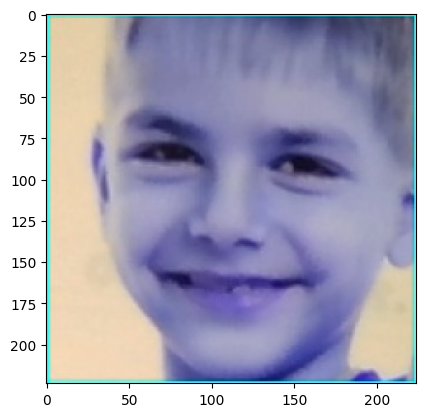

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.62173404e-07 9.99415994e-01 2.56073554e-06 4.69149029e-07
 1.18337506e-04 1.06052721e-05 4.46963037e-04 4.68279814e-06
 3.34143407e-10]
The he predicted facial expression is 1


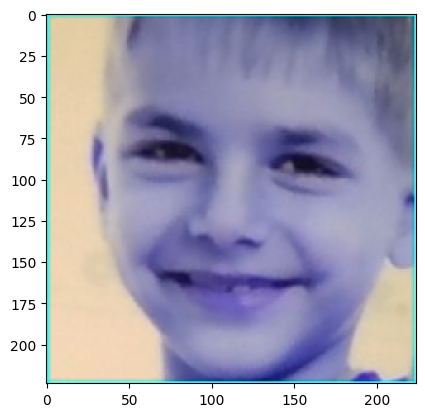

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.8380972e-05 9.9563146e-01 4.5797533e-05 1.3803442e-05 6.0849823e-04
 1.5620264e-04 3.4974704e-03 2.8400125e-05 2.9193428e-08]
The he predicted facial expression is 1


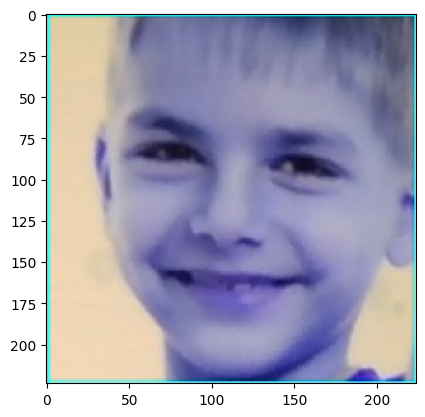

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.3054088e-06 9.9958593e-01 8.7469452e-06 2.7995870e-06 2.4131175e-05
 3.0102216e-05 3.4582600e-04 1.1639082e-06 2.3337432e-10]
The he predicted facial expression is 1


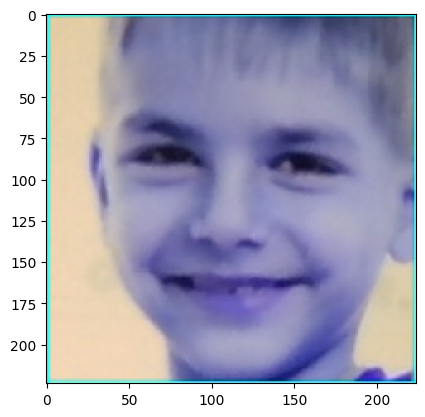

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.8322428e-05 3.5288846e-03 7.9306970e-05 3.4748282e-06 1.3977135e-04
 1.0334217e-02 4.5592987e-04 9.8113990e-01 4.2502563e-03]
The he predicted facial expression is 7


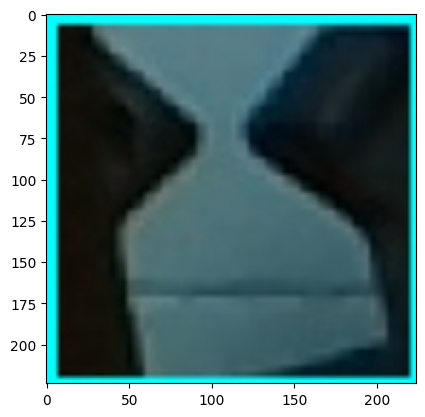

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.8644109e-06 9.9934846e-01 5.8016030e-06 4.1580665e-06 3.5085246e-05
 3.9939354e-05 5.6335790e-04 1.2923146e-06 1.8084557e-10]
The he predicted facial expression is 1


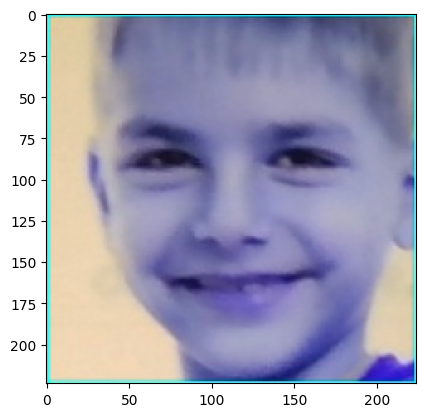

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.4364762e-05 9.8414671e-01 2.8349828e-05 2.8639793e-06 3.0507511e-03
 1.3273994e-03 9.5191747e-03 1.8500468e-03 3.1954372e-07]
The he predicted facial expression is 1


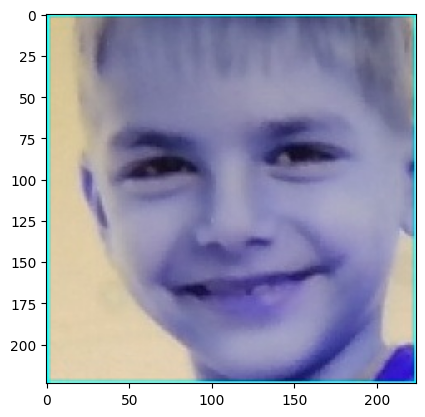

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.07021726e-04 9.88702536e-01 3.49625188e-05 1.21361682e-05
 8.76442762e-04 1.55412103e-03 8.62373132e-03 8.90592419e-05
 2.66087987e-08]
The he predicted facial expression is 1


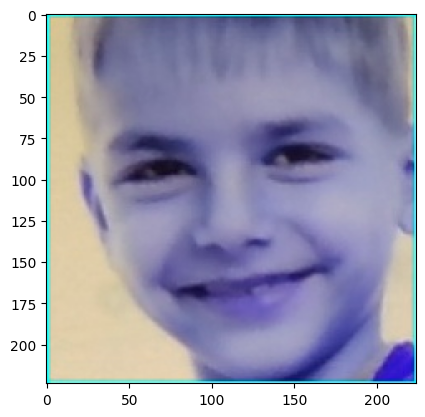

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.3998945e-05 9.9299121e-01 4.9404089e-06 1.2218489e-05 8.1029262e-05
 1.4999489e-03 5.3447606e-03 1.8596951e-06 8.6356262e-11]
The he predicted facial expression is 1


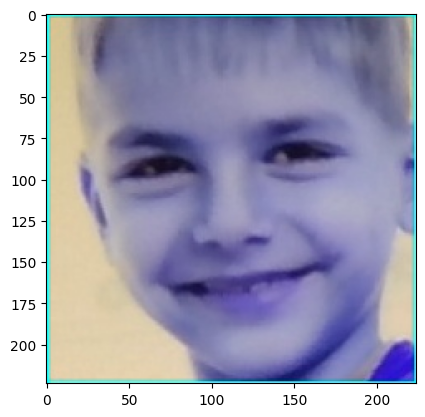

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.5133190e-04 3.6993087e-03 2.2996909e-03 1.1685306e-03 5.3326646e-04
 4.2316304e-03 9.1155682e-04 9.4381332e-01 4.2891439e-02]
The he predicted facial expression is 7


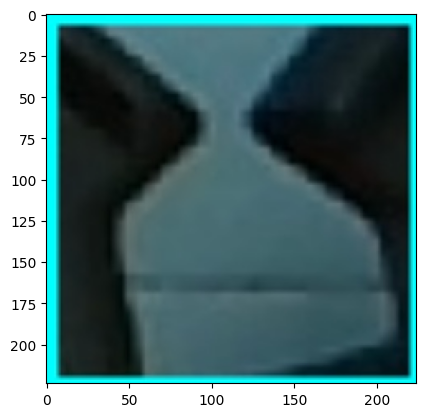

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.0058331e-06 9.9884510e-01 8.9171078e-07 2.7800734e-06 9.6204394e-07
 5.8204331e-04 5.6111999e-04 9.2702344e-08 4.9438947e-13]
The he predicted facial expression is 1


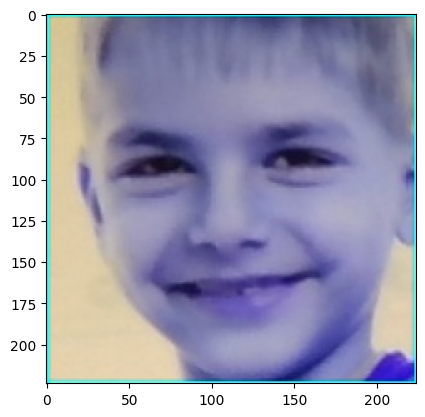

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.0149923e-06 9.9877244e-01 2.1250360e-06 1.2035745e-06 2.3463454e-05
 5.1544452e-05 1.1428099e-03 3.4906802e-07 5.8941720e-11]
The he predicted facial expression is 1


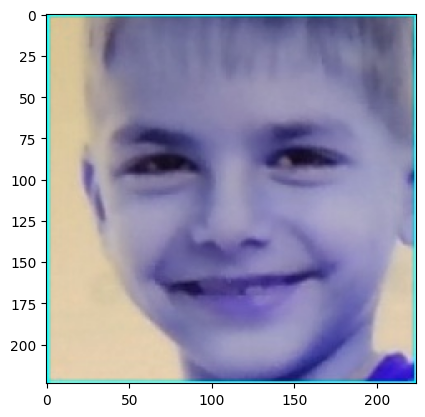

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.3487519e-07 9.9980789e-01 3.2282881e-07 1.3214147e-06 8.8397499e-08
 3.9177427e-05 1.5047302e-04 2.2079791e-09 1.5399975e-14]
The he predicted facial expression is 1


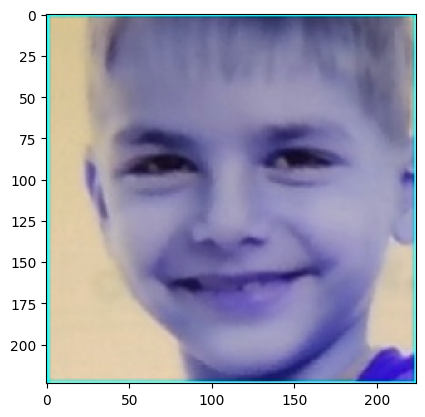

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.1381626e-07 9.9985826e-01 2.0717598e-08 3.6932974e-08 1.2775689e-06
 1.7550918e-06 1.3857039e-04 4.9842730e-09 3.0029239e-14]
The he predicted facial expression is 1


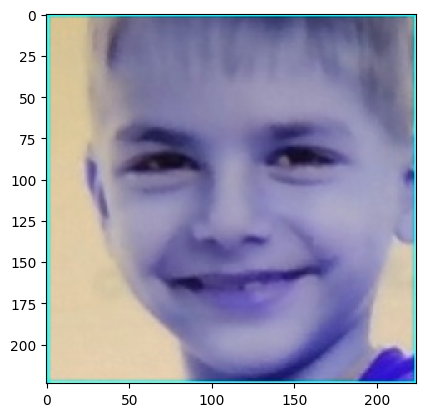

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.1650588e-07 9.9975592e-01 1.3618142e-06 4.6887064e-07 1.2533619e-05
 9.5479418e-06 2.1952100e-04 3.1393404e-07 1.9229203e-11]
The he predicted facial expression is 1


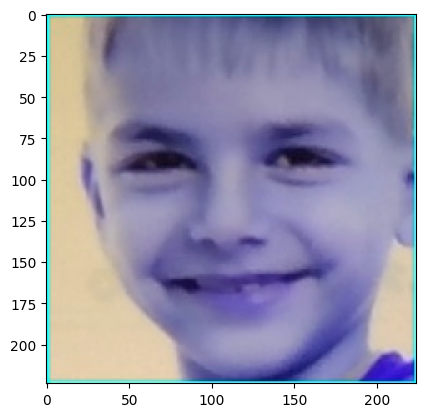

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.5357146e-07 9.9984598e-01 1.6056745e-07 9.2282484e-08 1.6370260e-06
 3.1915617e-06 1.4845001e-04 4.6167813e-08 1.4432558e-12]
The he predicted facial expression is 1


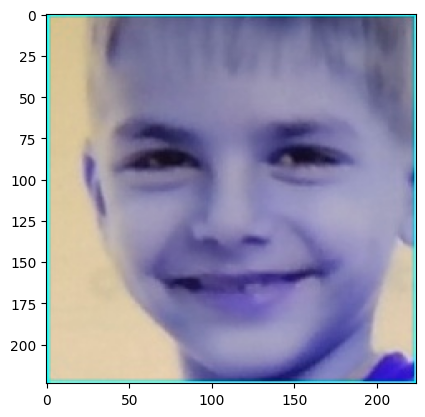

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.4094545e-06 9.9913055e-01 5.2536609e-07 2.0555149e-06 2.9570299e-06
 1.5402189e-04 7.0544786e-04 4.2156923e-08 4.2633982e-13]
The he predicted facial expression is 1


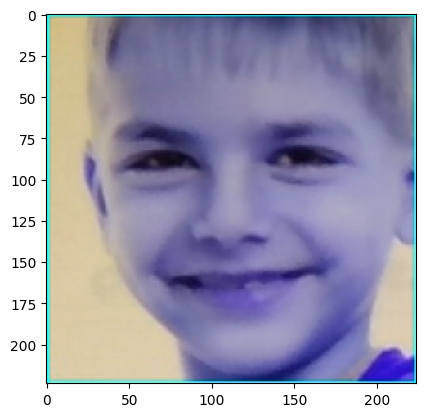

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.3992668e-06 9.9876887e-01 3.8546805e-06 7.7658922e-07 1.7677475e-04
 3.4669865e-05 1.0020063e-03 1.0666240e-05 1.2021459e-09]
The he predicted facial expression is 1


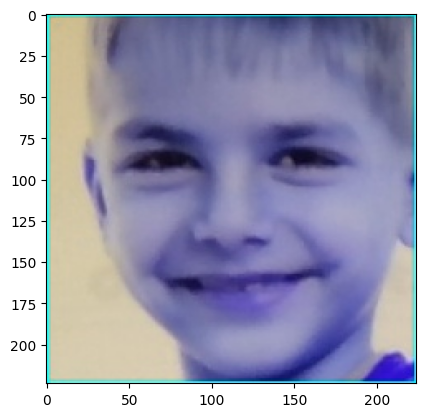

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[8.3600979e-05 1.6663799e-03 8.5827749e-05 1.5128420e-05 5.7803878e-05
 6.8048779e-03 2.6208171e-04 9.8349285e-01 7.5314371e-03]
The he predicted facial expression is 7


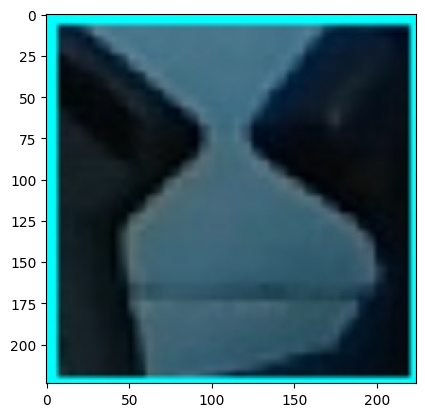

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.3402066e-07 9.9976021e-01 1.8584063e-07 2.4683217e-07 7.8865116e-07
 7.4094442e-06 2.3041535e-04 8.3049319e-09 3.1431791e-13]
The he predicted facial expression is 1


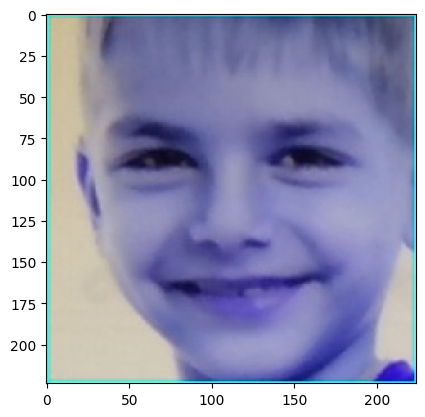

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[8.0323150e-07 9.9981242e-01 1.9933668e-06 3.0936826e-06 5.4322004e-07
 2.3510742e-05 1.5753155e-04 2.3616954e-08 1.2863724e-12]
The he predicted facial expression is 1


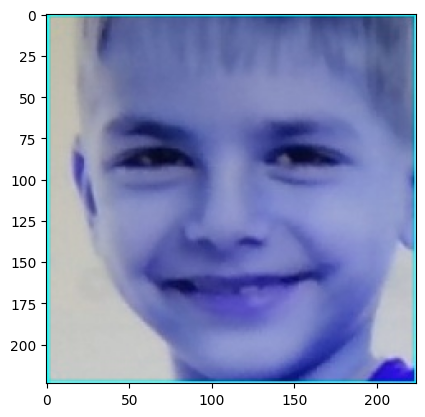

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.8743043e-03 1.8954325e-02 4.1239806e-03 6.3510955e-04 1.2474299e-03
 1.1602293e-01 5.2154851e-03 8.3668661e-01 1.5239862e-02]
The he predicted facial expression is 7


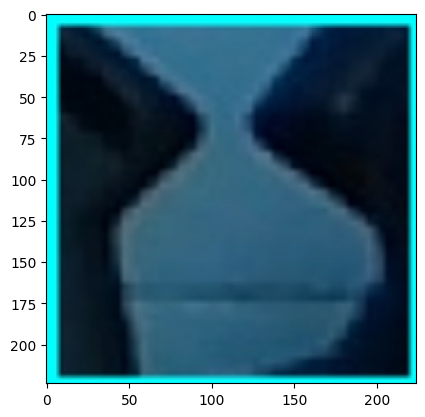

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.9127181e-07 9.9968696e-01 1.5702079e-07 1.6949103e-07 4.8941233e-06
 5.6177041e-06 3.0170864e-04 4.5219831e-08 1.2127326e-12]
The he predicted facial expression is 1


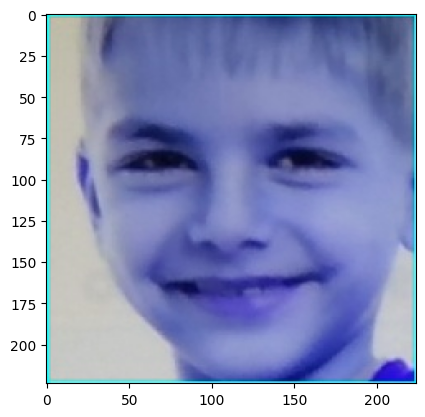

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.6697837e-04 2.5999751e-03 2.0198585e-04 9.0551111e-05 1.7846673e-04
 6.1643529e-03 5.6104566e-04 9.7691786e-01 1.3118758e-02]
The he predicted facial expression is 7


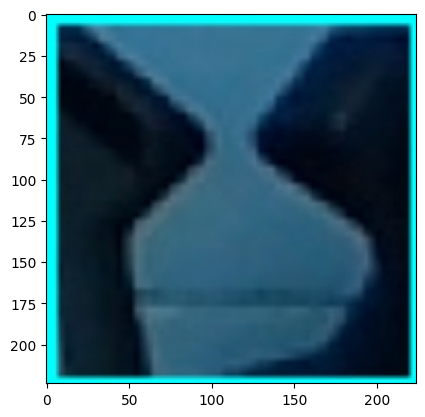

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.4548771e-05 9.9755043e-01 9.5289952e-06 2.4843341e-06 1.4440405e-04
 6.0612248e-05 2.2108618e-03 7.2036337e-06 5.4091851e-09]
The he predicted facial expression is 1


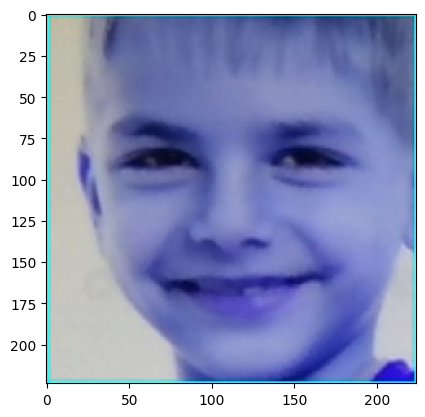

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.8631724e-04 8.9996895e-03 5.0615211e-04 3.7432277e-05 3.6408406e-04
 8.8370577e-02 1.8115205e-03 8.9464331e-01 4.7808499e-03]
The he predicted facial expression is 7


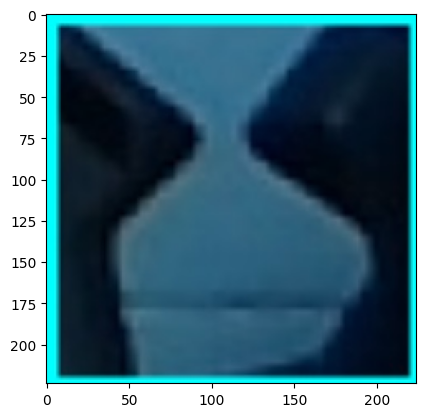

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.8440626e-06 9.9459863e-01 8.6163207e-05 7.0460728e-06 2.3663878e-03
 1.0925987e-04 2.5366966e-03 2.8770798e-04 2.4663038e-07]
The he predicted facial expression is 1


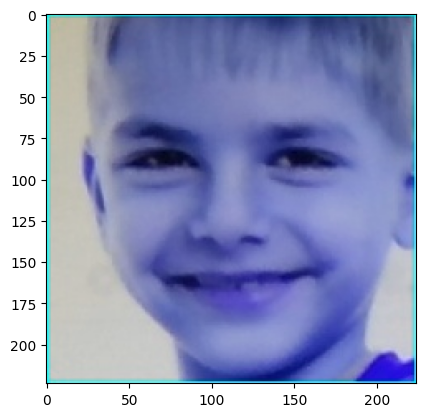

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.9728158e-04 5.1360838e-03 1.0308659e-03 4.3867261e-05 4.2555947e-04
 1.5694227e-02 8.5184723e-04 9.6517056e-01 1.1449643e-02]
The he predicted facial expression is 7


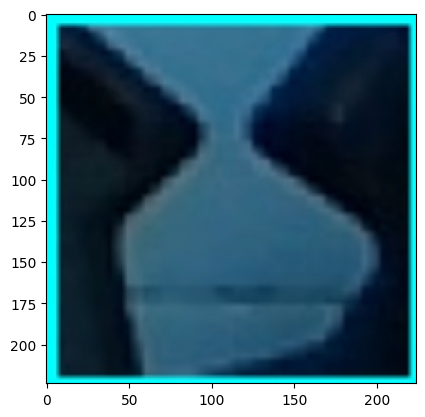

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.8956797e-07 9.9893528e-01 2.5534841e-06 1.8912080e-07 3.5126807e-04
 9.1001402e-06 6.8056100e-04 2.0381842e-05 2.0594539e-09]
The he predicted facial expression is 1


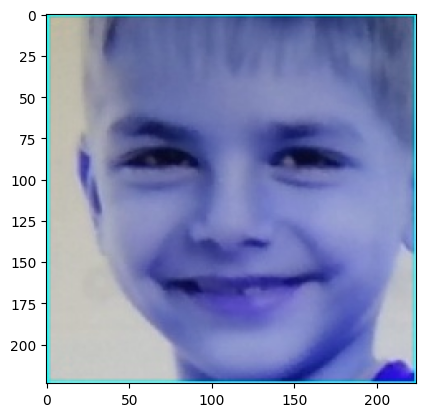

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.5691919e-07 9.9989784e-01 3.5022302e-07 3.1858443e-07 1.4792942e-06
 5.2052192e-06 9.4592433e-05 1.4485681e-08 3.3620635e-13]
The he predicted facial expression is 1


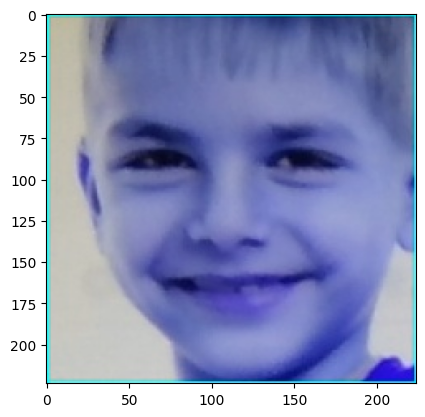

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.5066679e-04 2.5318812e-03 1.8386744e-04 2.0621783e-05 1.0301278e-04
 3.2748297e-02 6.0677272e-04 9.5814049e-01 5.5144979e-03]
The he predicted facial expression is 7


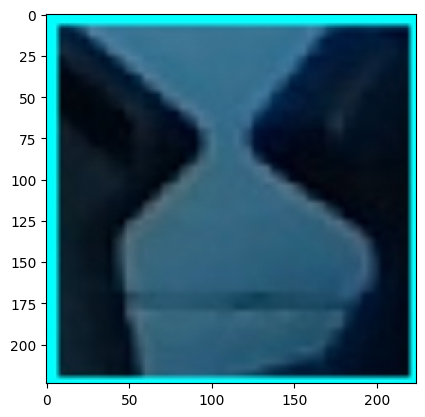

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.4150701e-06 9.9937469e-01 3.1819280e-05 1.2886827e-05 3.0164010e-05
 6.2343228e-05 4.8347065e-04 1.1946071e-06 3.4301231e-10]
The he predicted facial expression is 1


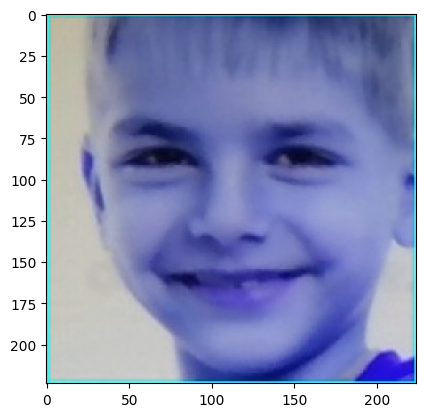

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.92341099e-05 4.10952372e-03 6.83183025e-05 2.87837679e-06
 1.19458375e-04 4.53007640e-03 3.23880318e-04 9.87459898e-01
 3.34686646e-03]
The he predicted facial expression is 7


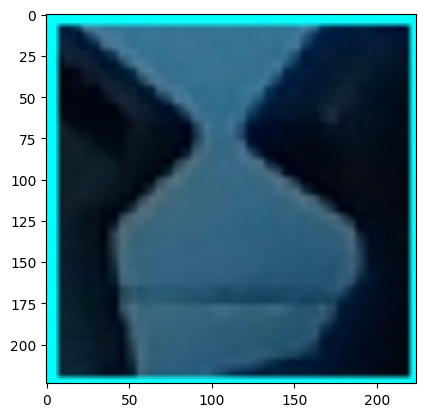

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.2558416e-06 9.9863583e-01 2.0652398e-05 2.9407768e-06 2.6474579e-04
 4.6211444e-05 1.0035366e-03 2.2835544e-05 9.2910133e-09]
The he predicted facial expression is 1


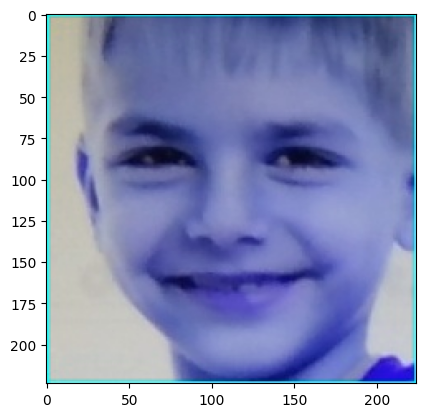

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.4460262e-04 3.7604631e-03 4.1090185e-04 1.9631101e-04 2.1497106e-04
 1.1823009e-02 8.1912108e-04 9.6460062e-01 1.7830057e-02]
The he predicted facial expression is 7


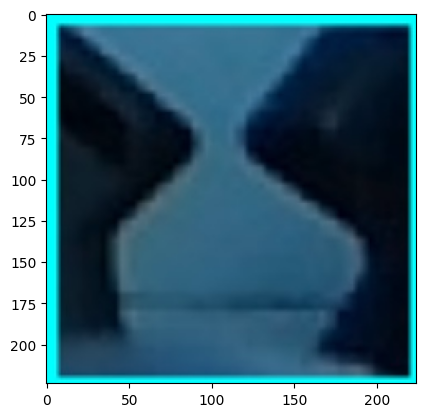

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.5671792e-08 9.9991202e-01 4.8482008e-07 2.6480501e-07 3.9014885e-06
 4.2372521e-06 7.8902151e-05 5.9927920e-08 9.5041173e-13]
The he predicted facial expression is 1


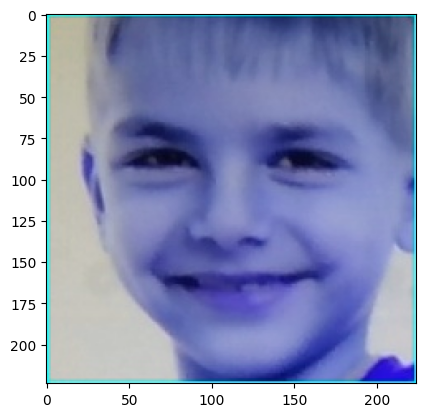

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.4615016e-08 9.9993336e-01 2.4667996e-08 6.0524439e-09 1.1365705e-06
 6.3735467e-07 6.4721258e-05 2.0737222e-08 2.1774855e-13]
The he predicted facial expression is 1


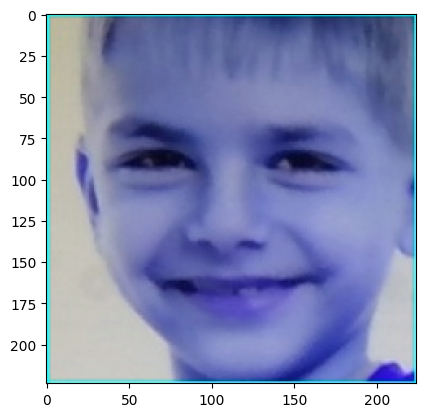

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.2117395e-07 9.9979371e-01 8.1827466e-07 2.7881896e-07 1.3628173e-05
 6.2301742e-06 1.8490310e-04 2.8284208e-07 1.0164161e-11]
The he predicted facial expression is 1


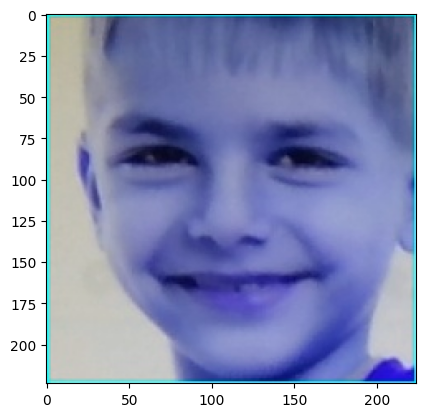

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.9978433e-07 9.9945682e-01 2.6031603e-06 5.1511739e-07 9.1338399e-05
 1.1857624e-05 4.3378578e-04 2.5697575e-06 1.9293324e-10]
The he predicted facial expression is 1


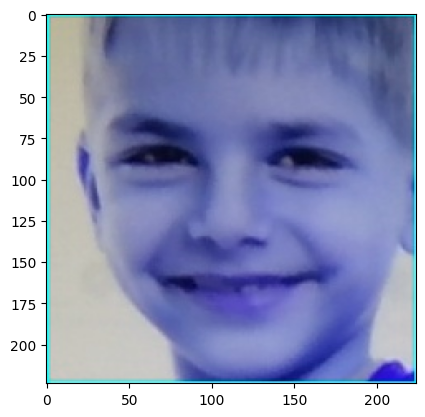

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.3968934e-07 9.9986362e-01 8.5106683e-07 7.7765469e-07 2.6738014e-06
 8.8208490e-06 1.2285756e-04 3.8556792e-08 1.3659448e-12]
The he predicted facial expression is 1


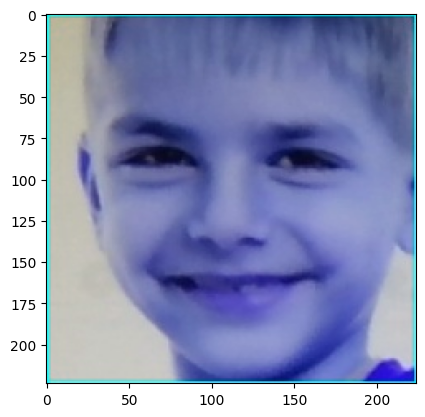

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.1838841e-04 9.7046383e-03 8.4797386e-04 2.9993366e-04 8.6845434e-04
 1.7578220e-02 2.2766602e-03 9.4476295e-01 2.3042703e-02]
The he predicted facial expression is 7


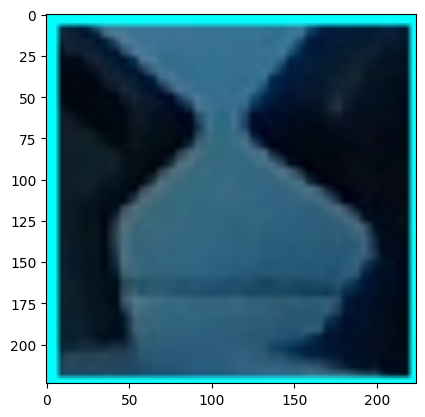

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.9232333e-07 9.9979717e-01 8.7255336e-07 5.8532885e-07 4.7147882e-06
 9.8128385e-06 1.8647555e-04 6.0286268e-08 2.9216100e-12]
The he predicted facial expression is 1


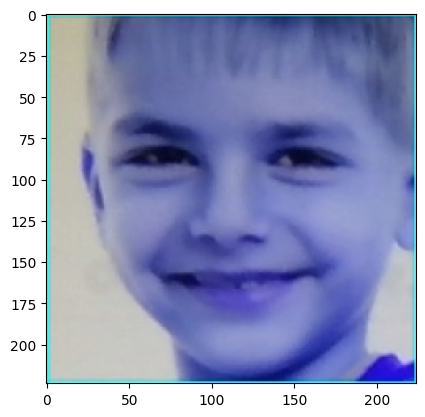

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.2812928e-04 8.8372221e-03 8.7574101e-04 4.3204382e-05 1.1381991e-03
 3.6845092e-02 2.4576841e-03 9.3817884e-01 1.1195784e-02]
The he predicted facial expression is 7


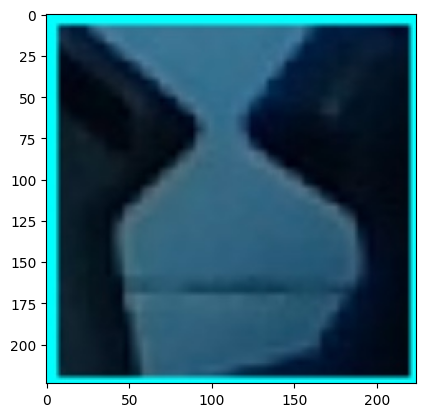

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.9096952e-06 9.9922407e-01 1.2184909e-05 2.8508789e-06 6.8613139e-05
 3.5217374e-05 6.4914796e-04 5.0933427e-06 1.4423327e-09]
The he predicted facial expression is 1


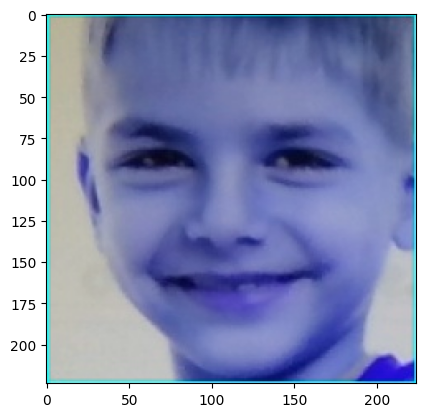

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.9540242e-04 4.7234781e-03 1.5328784e-03 1.7426816e-04 4.2686463e-04
 1.1200739e-02 7.9774176e-04 9.6090817e-01 1.9940529e-02]
The he predicted facial expression is 7


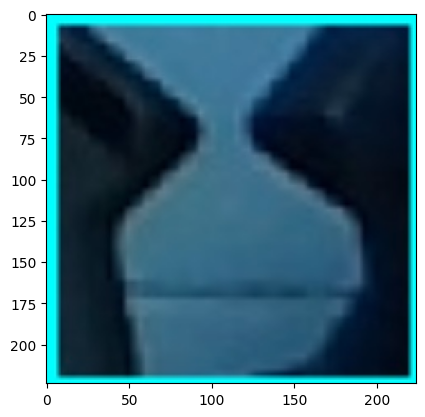

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.3717208e-06 9.9854565e-01 1.9517905e-05 2.6409625e-06 2.8910299e-04
 4.5326076e-05 1.0721665e-03 2.2370263e-05 9.2250358e-09]
The he predicted facial expression is 1


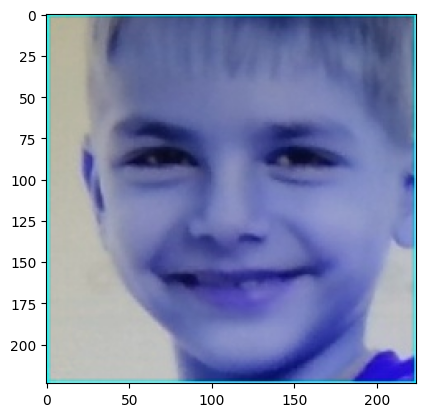

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.5162401e-04 9.8665273e-03 4.7256783e-04 3.4551333e-05 2.5783197e-04
 3.3848245e-02 1.1147432e-03 9.4974196e-01 4.4120080e-03]
The he predicted facial expression is 7


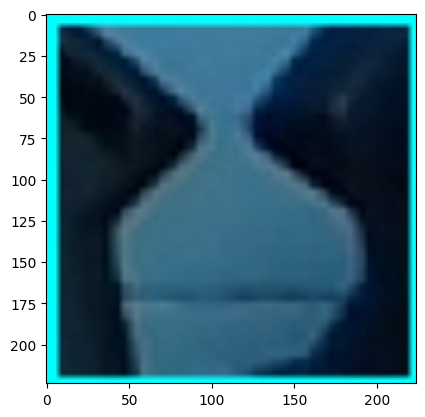

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.5177333e-08 9.9997997e-01 1.3017491e-08 3.5410054e-08 3.6447648e-08
 9.1344464e-07 1.9070922e-05 1.3219598e-10 2.4207503e-16]
The he predicted facial expression is 1


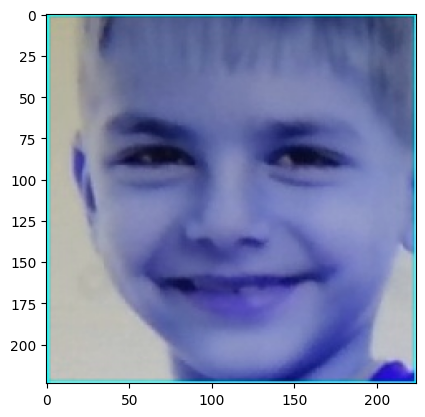

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.1264251e-03 1.6652534e-02 1.6980214e-03 2.0967136e-04 5.2228424e-04
 1.2520808e-01 3.0399109e-03 8.4394360e-01 7.5995135e-03]
The he predicted facial expression is 7


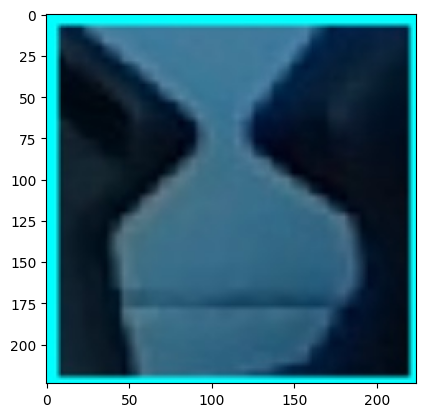

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.9501415e-07 9.9977654e-01 9.3058856e-07 3.3393053e-07 1.7197355e-05
 7.0641372e-06 1.9748961e-04 2.1704483e-07 7.0509505e-12]
The he predicted facial expression is 1


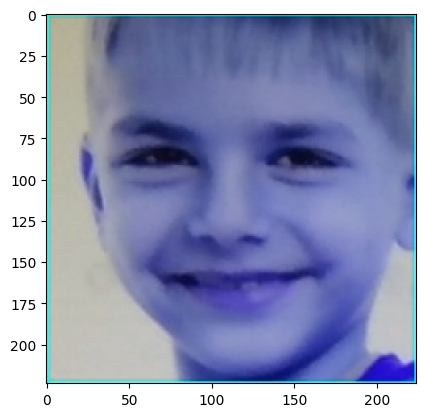

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.7822814e-04 1.2480735e-02 5.4411078e-04 7.4333642e-05 6.5858132e-04
 1.3882535e-02 1.6774759e-03 9.5939565e-01 1.1008477e-02]
The he predicted facial expression is 7


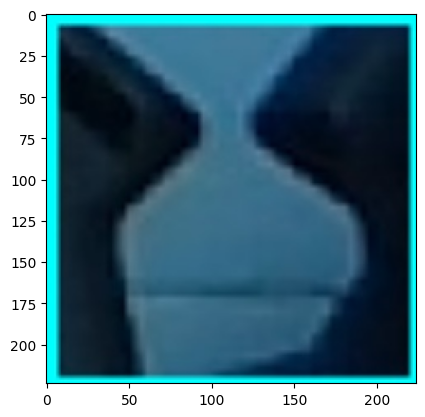

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.7972694e-07 9.9964535e-01 5.3813733e-07 2.7715205e-07 1.9791722e-05
 7.3331757e-06 3.2608773e-04 2.8312934e-07 9.8752638e-12]
The he predicted facial expression is 1


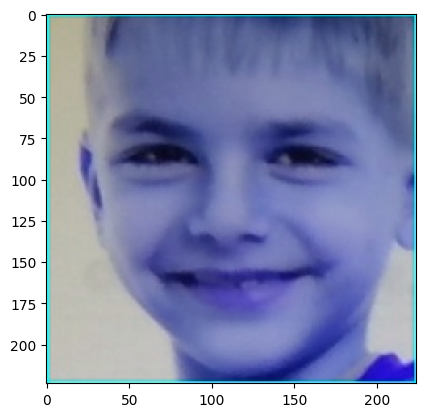

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.5717850e-04 1.0039190e-02 5.0779205e-04 5.3888733e-05 4.0966037e-04
 2.6258815e-02 1.4901217e-03 9.5522028e-01 5.7630367e-03]
The he predicted facial expression is 7


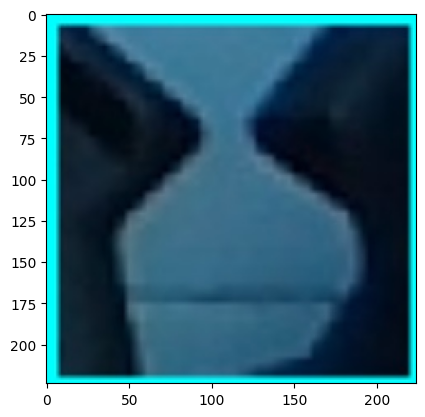

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.1248663e-07 9.9984968e-01 2.9212362e-07 5.4347140e-07 5.5029631e-07
 8.1975577e-06 1.4035862e-04 5.9173511e-09 1.3239580e-13]
The he predicted facial expression is 1


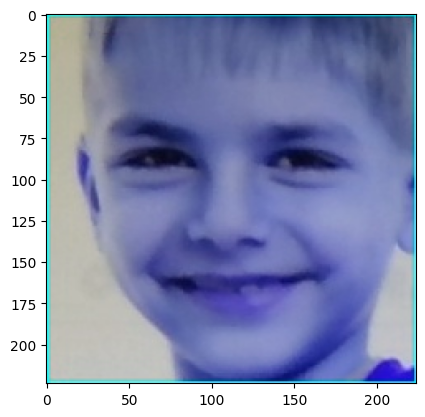

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[5.3593107e-05 5.8805436e-04 1.5005151e-04 8.6342825e-06 5.7559196e-06
 1.9050328e-02 6.7205750e-05 9.7749954e-01 2.5767870e-03]
The he predicted facial expression is 7


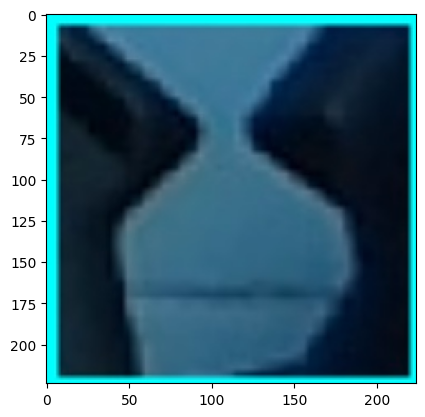

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[5.3347594e-07 9.9979752e-01 2.0252983e-07 8.0907114e-08 2.8449244e-06
 3.8609282e-06 1.9498990e-04 7.2488028e-08 3.7063456e-12]
The he predicted facial expression is 1


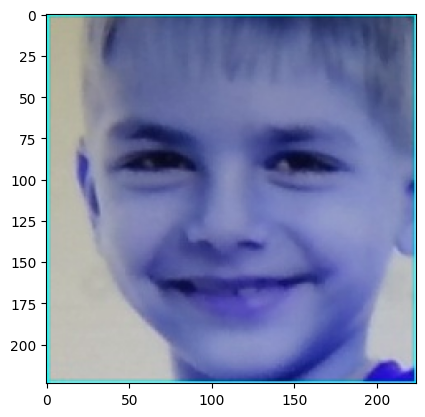

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.9170648e-04 1.4704150e-02 3.6647558e-04 2.1504871e-05 9.5184339e-04
 1.9381456e-02 1.8871591e-03 9.5748508e-01 5.0106109e-03]
The he predicted facial expression is 7


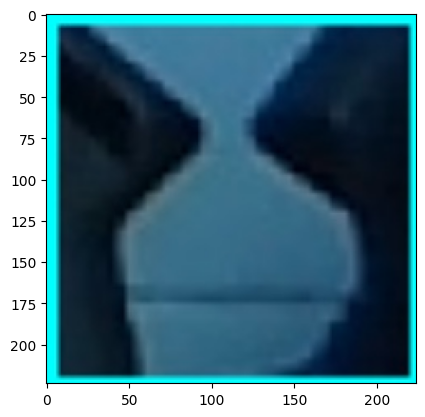

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.65206849e-08 9.99884844e-01 4.21203879e-07 9.33593043e-08
 9.88644297e-06 2.82880160e-06 1.01685175e-04 1.96670513e-07
 3.78398961e-12]
The he predicted facial expression is 1


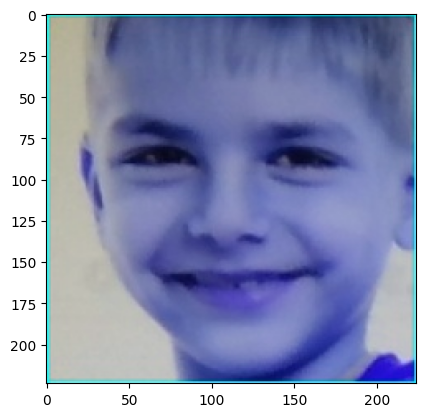

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[6.2186459e-08 9.9994242e-01 2.6522051e-07 3.1238986e-07 7.3222037e-07
 3.9319266e-06 5.2234653e-05 5.3178093e-09 6.3257430e-14]
The he predicted facial expression is 1


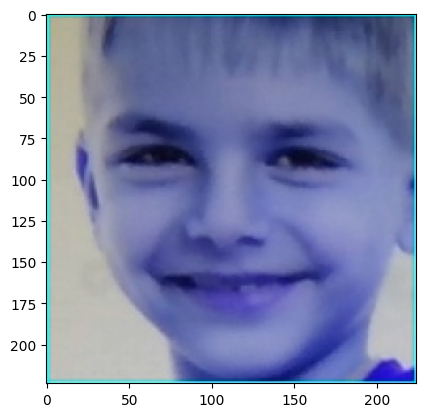

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[7.0890581e-04 1.5262642e-02 8.7855436e-04 9.6826370e-05 1.0064126e-03
 4.3803312e-02 3.3808025e-03 9.2123324e-01 1.3629326e-02]
The he predicted facial expression is 7


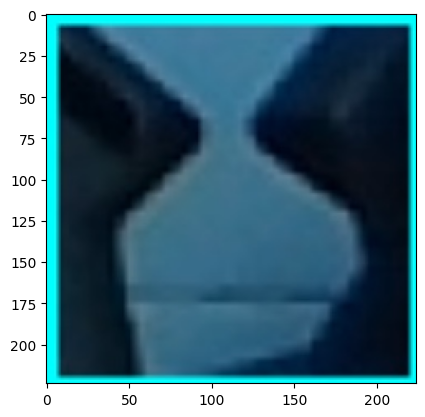

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.9826926e-05 9.9485070e-01 3.0842598e-04 3.1923093e-05 1.4486033e-03
 2.5445790e-04 2.4482473e-03 6.3645269e-04 1.3159771e-06]
The he predicted facial expression is 1


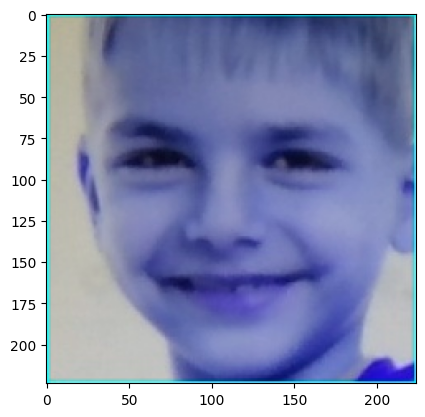

a Number of detected faces: 2
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[5.3059892e-08 1.1649406e-07 1.5007714e-07 2.2312404e-06 3.0587998e-08
 4.2480815e-07 2.2960128e-07 3.1757794e-02 9.6823901e-01]
The he predicted facial expression is 8


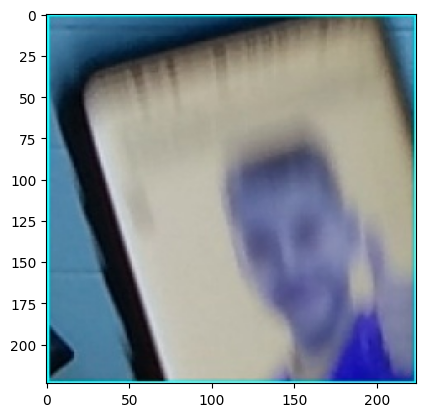

C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[0.02938445 0.03039411 0.04108862 0.10819808 0.03070544 0.04294273
 0.061326   0.16165243 0.49430814]
The he predicted facial expression is 8


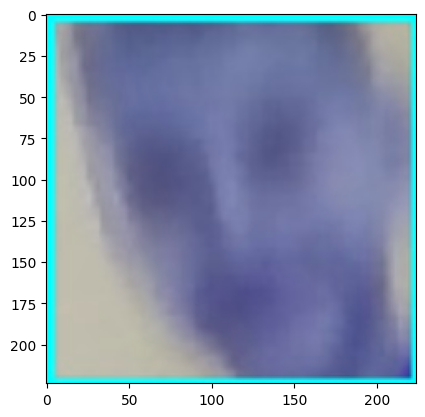

a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[5.3591528e-05 9.9339312e-01 2.3523941e-04 7.9851146e-05 8.7579514e-04
 1.3960429e-03 3.6990584e-03 2.6706036e-04 1.1237230e-07]
The he predicted facial expression is 1


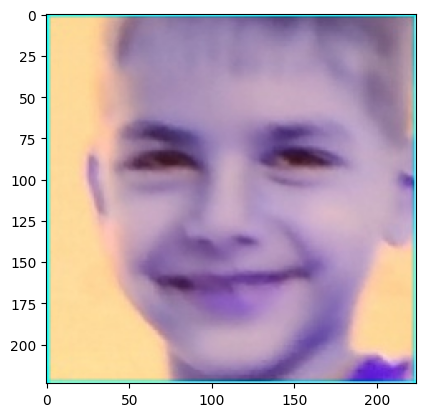

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.5196912e-03 6.8315285e-01 3.3938441e-02 4.3108225e-02 2.0187724e-02
 3.9961368e-02 2.1078670e-02 1.5677471e-01 2.7829470e-04]
The he predicted facial expression is 1


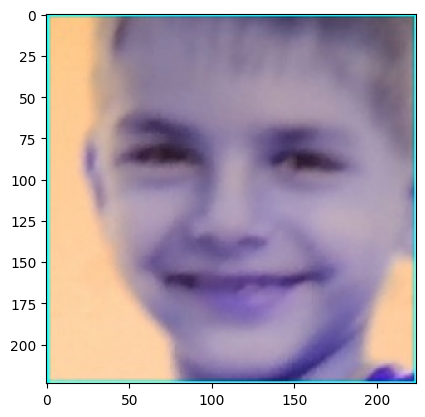

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.9343247e-04 9.7351170e-01 2.4418754e-03 9.6012482e-05 6.8574934e-03
 8.4819004e-04 9.6722068e-03 6.1432053e-03 1.3592717e-04]
The he predicted facial expression is 1


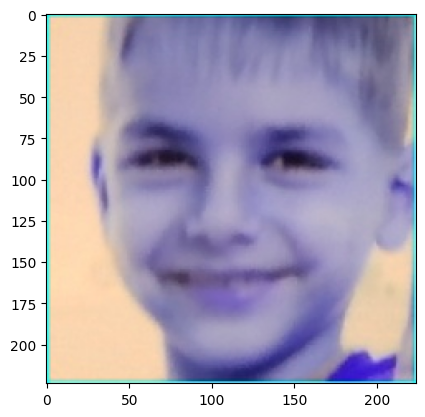

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.8976146e-03 8.0890983e-01 2.8007945e-02 2.1340637e-02 3.2198410e-02
 2.2732234e-02 3.9552584e-02 4.4118378e-02 2.4231529e-04]
The he predicted facial expression is 1


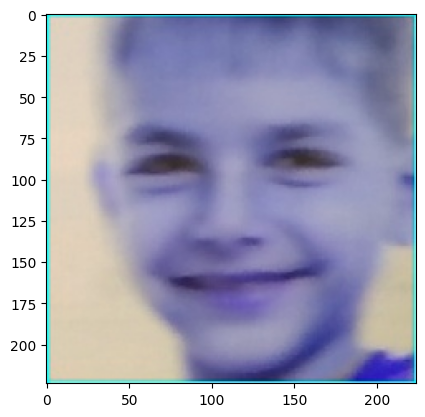

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.6729335e-06 9.9982125e-01 5.3480621e-06 4.7440885e-06 3.3956101e-07
 2.6019085e-05 1.3967844e-04 4.4815533e-08 5.4751533e-12]
The he predicted facial expression is 1


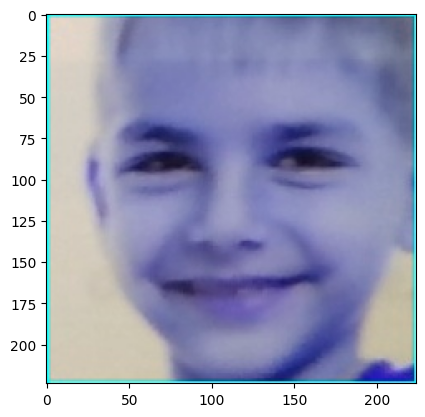

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.0118542e-08 2.7499949e-03 2.1048725e-06 6.9190087e-10 7.2437548e-04
 2.2385320e-06 1.0236015e-05 9.9646533e-01 4.5706074e-05]
The he predicted facial expression is 7


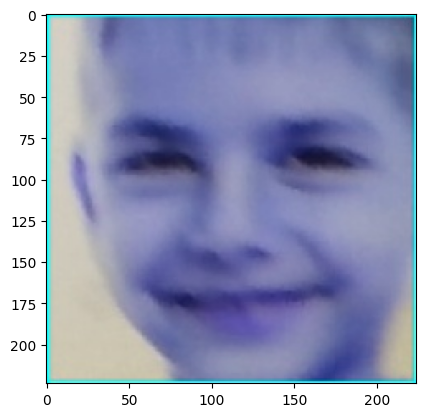

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[8.3091720e-09 1.7854279e-04 2.7171725e-07 9.4645147e-10 6.9382554e-06
 1.2256236e-06 1.3700844e-06 9.9957830e-01 2.3336770e-04]
The he predicted facial expression is 7


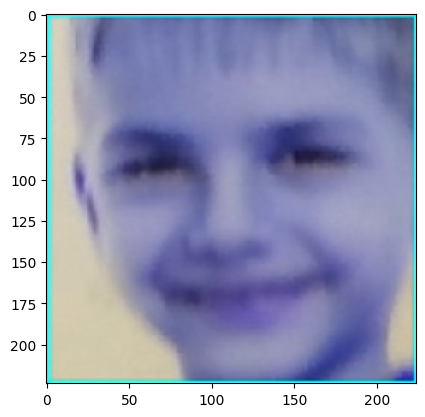

a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.4544147e-05 4.8063044e-03 5.2234699e-04 4.4518906e-06 9.5214532e-04
 1.3147522e-03 2.7100684e-04 9.8669589e-01 5.4185605e-03]
The he predicted facial expression is 7


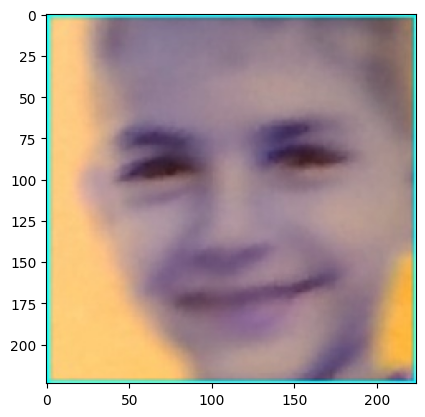

a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.1044186e-05 8.4405929e-01 7.1651384e-04 4.1224462e-06 1.0794498e-02
 2.5469789e-04 3.4153457e-03 1.4012481e-01 5.8967975e-04]
The he predicted facial expression is 1


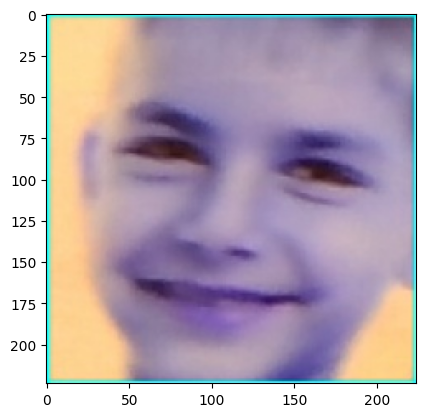

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.5934519e-04 8.0825651e-01 7.9394126e-04 6.4465515e-03 3.7767935e-05
 1.7875083e-01 5.1421588e-03 4.1285949e-04 6.6564527e-09]
The he predicted facial expression is 1


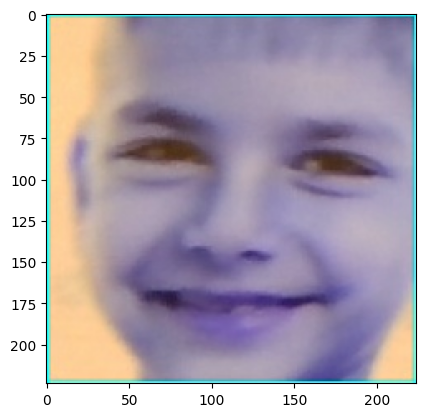

a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 0
a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.5400110e-06 6.0184556e-04 1.2387751e-04 3.6435954e-06 4.1818646e-05
 7.7089400e-04 4.1849729e-05 9.9739081e-01 1.0218472e-03]
The he predicted facial expression is 7


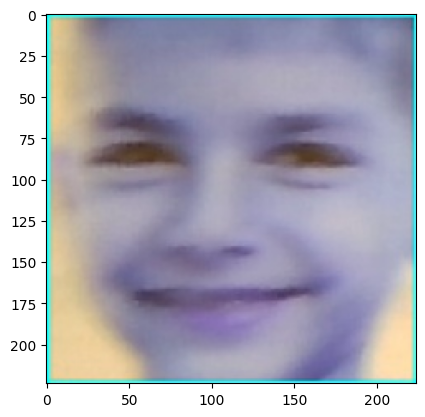

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.14104296e-07 9.99312401e-01 3.33536832e-07 1.53637270e-09
 3.45138251e-04 6.40816268e-07 2.19011534e-04 1.22341313e-04
 5.01323516e-09]
The he predicted facial expression is 1


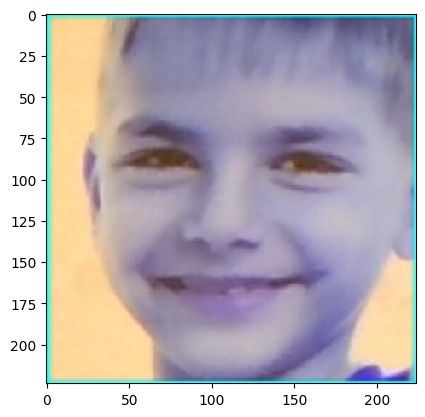

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.0778982e-07 9.9829727e-01 1.2234669e-06 4.6272186e-09 8.9339516e-04
 1.2336614e-06 3.1669470e-04 4.8995583e-04 5.1515535e-08]
The he predicted facial expression is 1


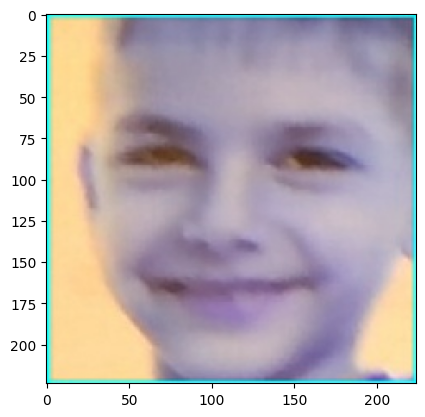

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.4801510e-06 5.0213616e-02 8.2501072e-05 1.8203779e-07 6.9243736e-03
 2.8802744e-05 3.0325839e-04 9.4167620e-01 7.6967757e-04]
The he predicted facial expression is 7


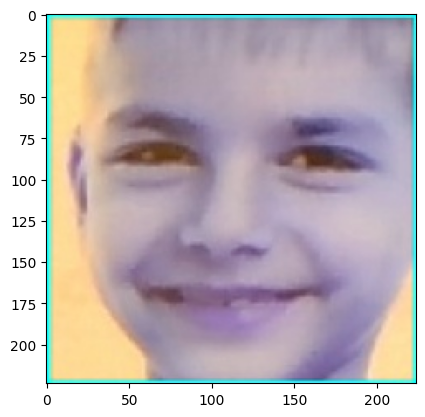

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.6222343e-07 9.8269248e-01 1.2781588e-05 5.5689448e-08 3.9984486e-03
 7.6213614e-06 5.3914642e-04 1.2747761e-02 1.2102316e-06]
The he predicted facial expression is 1


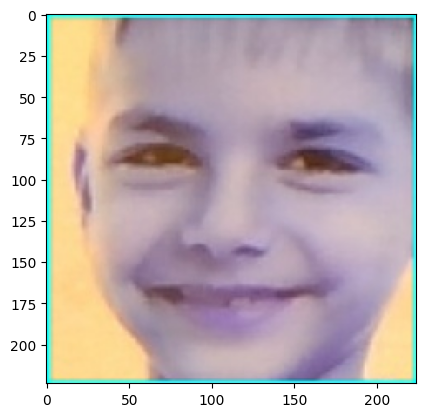

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.3263805e-07 9.9665534e-01 8.1087859e-07 1.9631068e-09 9.8279933e-04
 1.0334389e-06 2.4586194e-04 2.1138627e-03 8.0986425e-08]
The he predicted facial expression is 1


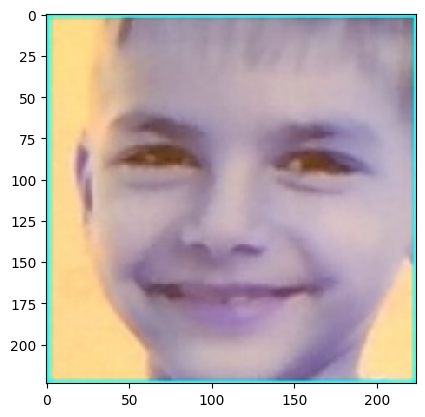

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.2201870e-06 9.9804127e-01 2.3090513e-06 4.3075570e-08 8.2609127e-04
 5.2392802e-06 9.5648167e-04 1.6728014e-04 3.6898641e-08]
The he predicted facial expression is 1


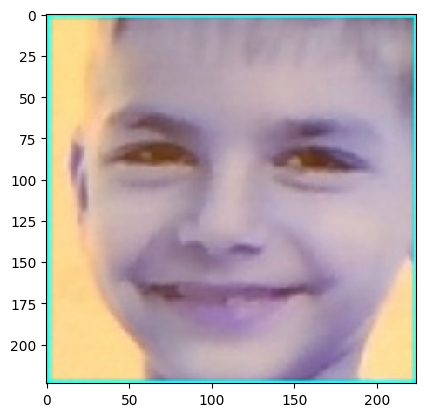

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.2756427e-06 7.5981092e-01 7.7442666e-05 2.2647110e-07 1.9826943e-02
 5.6871180e-05 9.9998480e-04 2.1919565e-01 3.0694096e-05]
The he predicted facial expression is 1


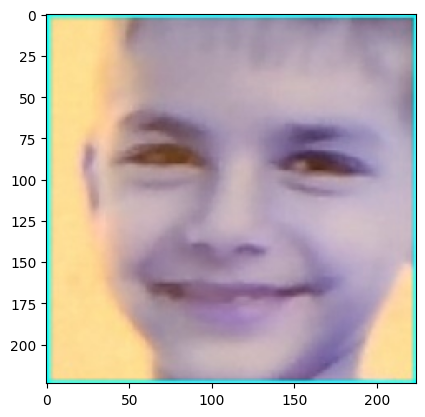

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.6405672e-07 9.9668914e-01 2.3278972e-06 1.2156192e-08 2.1434522e-03
 2.2035695e-06 5.1316136e-04 6.4935104e-04 7.5499706e-08]
The he predicted facial expression is 1


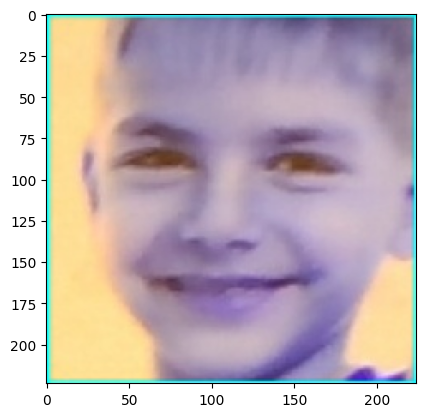

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.0587876e-07 9.9966538e-01 3.2747434e-07 1.9171891e-09 1.4028096e-04
 6.3321778e-07 1.6495846e-04 2.8331247e-05 1.6304461e-09]
The he predicted facial expression is 1


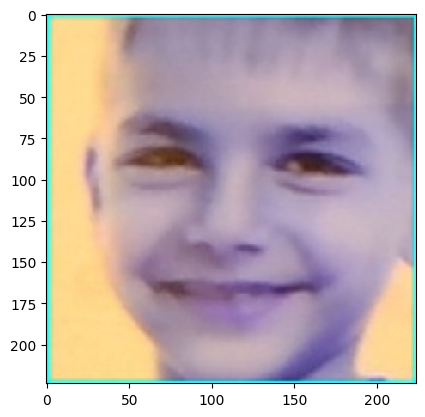

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.4159431e-07 3.5542220e-01 1.9850909e-06 9.9409603e-10 8.5642496e-03
 2.4245026e-06 4.4271792e-04 6.3551486e-01 5.1291758e-05]
The he predicted facial expression is 7


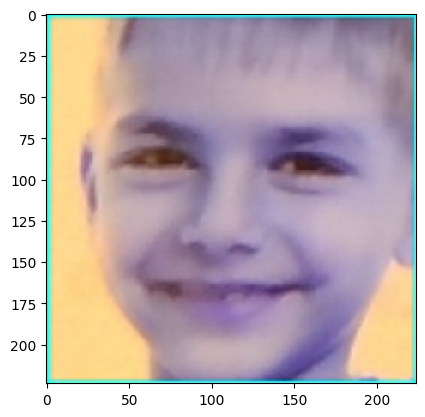

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.4671858e-06 6.5189338e-01 1.3832324e-04 4.7862943e-07 3.2269385e-02
 6.3566426e-05 1.5929184e-03 3.1394184e-01 9.7580829e-05]
The he predicted facial expression is 1


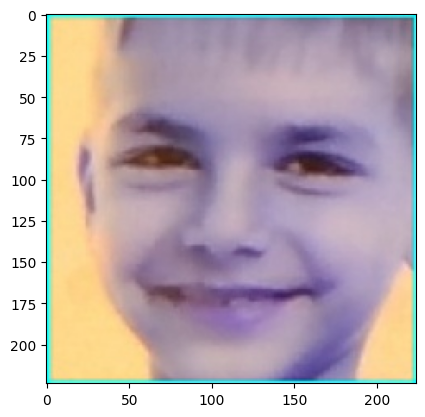

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.40810835e-06 8.74455392e-01 5.39026660e-05 1.12305777e-07
 1.50793865e-02 1.88052945e-05 1.03533990e-03 1.09316155e-01
 3.94363342e-05]
The he predicted facial expression is 1


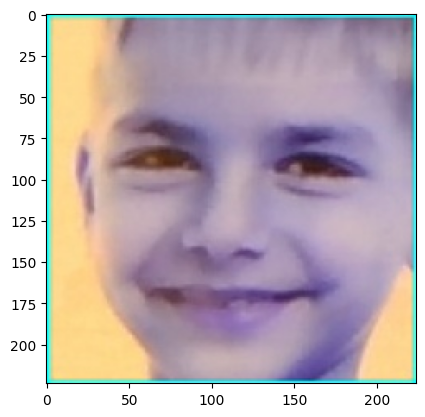

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.0650140e-06 9.6411008e-01 2.5335194e-05 8.5011550e-08 3.9198119e-03
 1.4287858e-05 6.4315874e-04 3.1280622e-02 5.6681611e-06]
The he predicted facial expression is 1


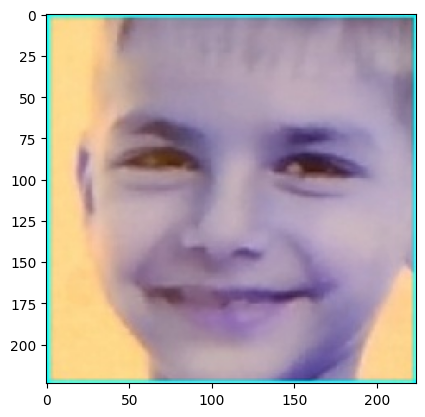

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[9.0491334e-08 9.9961311e-01 2.1845142e-07 2.0058677e-09 1.6878294e-04
 6.0428647e-07 1.9189448e-04 2.5342044e-05 9.5118435e-10]
The he predicted facial expression is 1


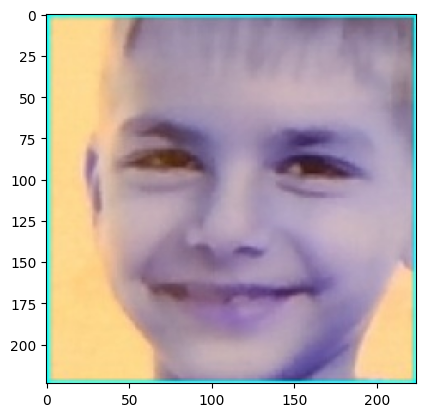

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.9487337e-07 9.9949121e-01 5.5584604e-07 3.0089082e-09 2.1231976e-04
 9.0333100e-07 2.3073261e-04 6.3932232e-05 6.1280190e-09]
The he predicted facial expression is 1


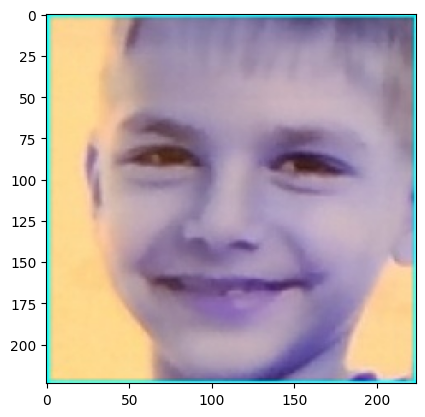

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.5107854e-07 9.9922228e-01 3.9370377e-07 5.4516924e-09 2.7587826e-04
 1.4244279e-06 4.7381828e-04 2.5914625e-05 2.2262046e-09]
The he predicted facial expression is 1


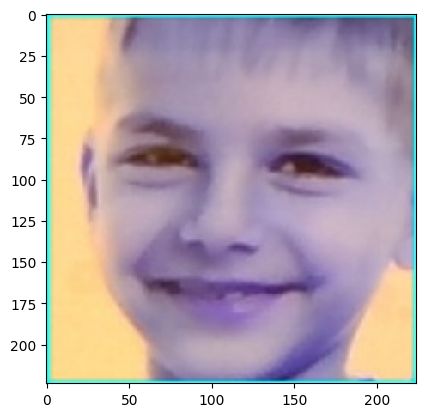

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[4.6767943e-07 9.9845016e-01 1.6634360e-05 7.3555988e-08 6.6161522e-04
 6.0115722e-06 2.8061494e-04 5.8415101e-04 2.0612808e-07]
The he predicted facial expression is 1


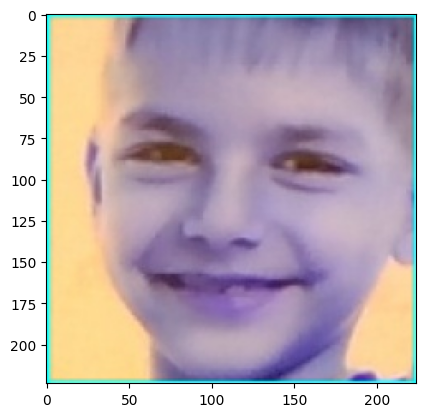

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.0997613e-06 9.8187822e-01 1.6201493e-05 4.6032447e-08 8.8751586e-03
 7.2964026e-06 1.0778568e-03 8.1404522e-03 3.6309834e-06]
The he predicted facial expression is 1


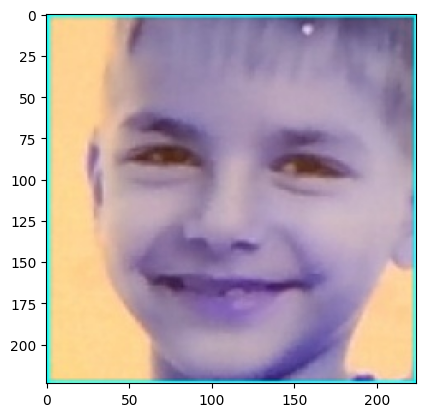

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.2895040e-06 9.7523934e-01 1.7626415e-05 8.1771411e-08 1.8705256e-02
 8.6682476e-06 2.1865678e-03 3.8369454e-03 4.3256850e-06]
The he predicted facial expression is 1


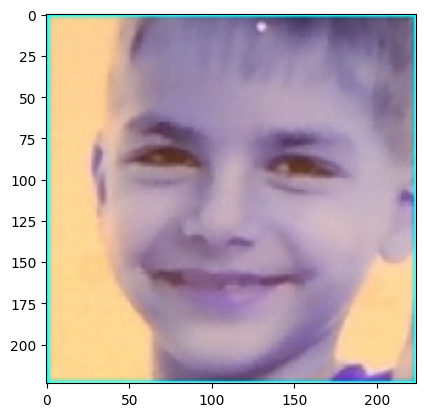

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.96935013e-07 9.99055564e-01 3.57854788e-07 2.06652540e-09
 4.18456329e-04 8.40740313e-07 4.39849857e-04 8.46475014e-05
 1.07761045e-08]
The he predicted facial expression is 1


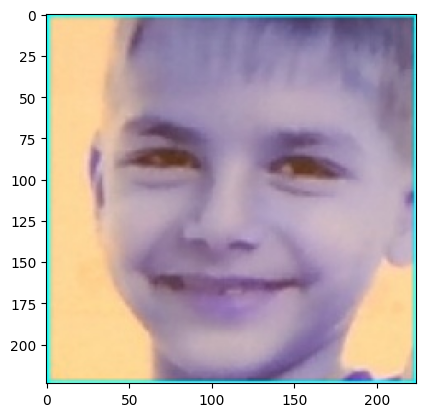

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[2.3817411e-06 9.9431205e-01 2.1568878e-05 2.6759778e-07 3.1423757e-03
 1.4401786e-05 1.6295008e-03 8.7602984e-04 1.4607035e-06]
The he predicted facial expression is 1


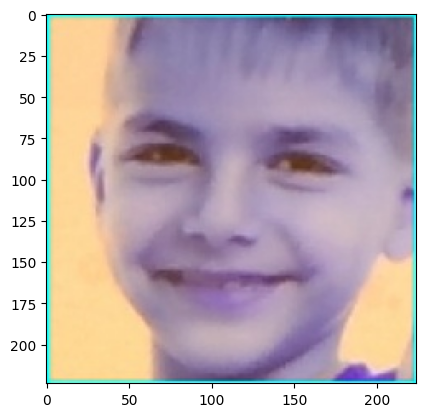

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.1865463e-06 9.9828857e-01 8.6773052e-06 3.3737535e-08 8.1619323e-04
 5.1825969e-06 6.0273096e-04 2.7736928e-04 1.7837542e-07]
The he predicted facial expression is 1


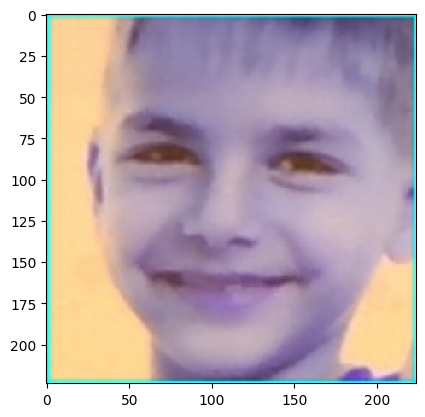

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[9.74351224e-06 9.81321633e-01 9.82463898e-05 1.48655511e-06
 1.11856675e-02 4.72021602e-05 4.79395408e-03 2.52240873e-03
 1.96685887e-05]
The he predicted facial expression is 1


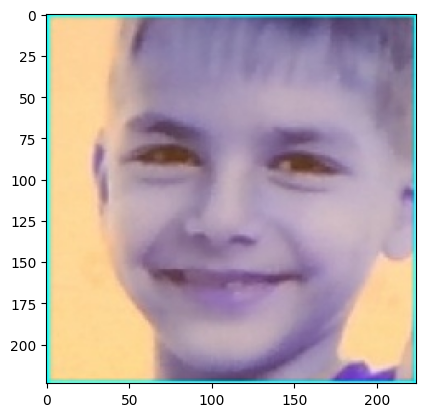

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[3.92705431e-07 9.99519467e-01 5.80670076e-07 1.27731257e-08
 1.16855656e-04 2.03699597e-06 3.47710797e-04 1.29310101e-05
 1.24776356e-09]
The he predicted facial expression is 1


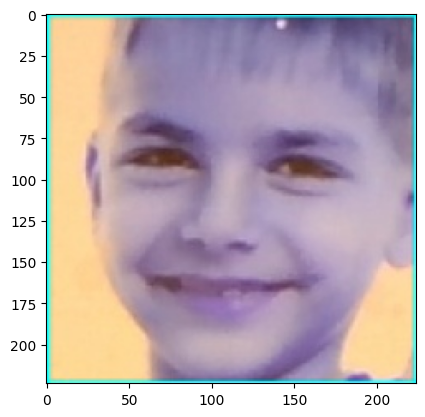

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.3532966e-06 7.8339463e-01 4.8142589e-05 6.7373456e-08 1.5760319e-02
 1.6903861e-05 9.2170667e-04 1.9978505e-01 7.1782073e-05]
The he predicted facial expression is 1


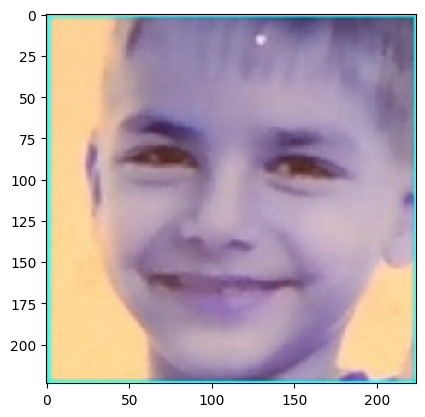

a Number of detected faces: 1
C:/Users/research/Desktop/thesis2/cap_face/nowface.jpg is saved
[1.3129525e-06 9.7272229e-01 8.4014982e-06 2.3298899e-08 1.6607165e-02
 3.7150528e-06 2.3209054e-03 8.3155287e-03 2.0602398e-05]
The he predicted facial expression is 1


KeyboardInterrupt: 

In [2]:
import os
import matplotlib.pyplot as plt
import numpy as np
#import tensorflow as tf
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import load_model

# import required libraries
import cv2
import os


ndir = "C:/Users/research/Desktop/thesis2/cap_face"
nmane = ndir + '/' + 'nowface.jpg'
new_modelp = load_model('my_mthesis_model_30ep.h5')

imgitem = 'nowface.jpg'

# read the haarcascade to detect the faces in an image
#face_cascade2 = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')
#face_cascade1 = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt2.xml')
#face_cascade3 = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_default.xml')
#face_cascade4 = cv2.CascadeClassifier('haarcascades/haarcascade_profileface.xml')

cap = cv2.VideoCapture(0)



while(True):
    #capture frame by frame
    ret, frame = cap.read()
    frame = cv2.resize(frame, (int(frame.shape[1] * 1.5), int(frame.shape[0] * 1.5)), interpolation = cv2.INTER_AREA)
    
    cv2.imwrite(imgitem, frame)
    
    img = cv2.imread(imgitem)
    
    
    
    # convert to grayscale of each frames
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # read the haarcascade to detect the faces in an image haarcascade_frontalface_alt
    face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_default.xml')

    # detects faces in the input image
    faces = face_cascade.detectMultiScale(gray, 1.1, 4)
    print('a Number of detected faces:', len(faces))
    
    ##if len(faces) == 0:
        # read the haarcascade to detect the faces in an image
        ##face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt2.xml')
        # detects faces in the input image
        ##faces = face_cascade.detectMultiScale(gray, 1.1, 2)
        ##print('b Number of detected faces:', len(faces))
    
    ##if len(faces) == 0:
        # read the haarcascade to detect the faces in an image
        ##face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_default.xml')
        # detects faces in the input image
        ##faces = face_cascade.detectMultiScale(gray, 1.3, 4)
        ##print('c Number of detected faces:', len(faces))
        
    ##if len(faces) == 0:
        # read the haarcascade to detect the faces in an image
        ##face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_profileface.xml')
        # detects faces in the input image
        ##faces = face_cascade.detectMultiScale(gray, 1.1, 2)
        ##print('d Number of detected faces:', len(faces))
    if len(faces) > 0:
        for i, (x, y, w, h) in enumerate(faces):
            # To draw a rectangle in a face
            cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 255), 2)
            face = img[y:y + h, x:x + w]
            #cv2.imshow("Cropped Face", face)
            face = cv2.resize(face, (224, 224))
            cv2.imwrite(f'{nmane}', face)
            print(f"{nmane} is saved")
            
            
            img1 = cv2.imread(nmane)
            #plt.imshow(img1)
            img1 = cv2.resize(img1, (224, 224))
            final_img = np.expand_dims(img1,axis =0) #adding fourth dimension
            final_img = final_img/255.0 #normalizing
            Predictions = new_modelp.predict(final_img)
            print(Predictions[0])
            model_pic_predict = np.argmax(Predictions)
            print("The he predicted facial expression is "+ str(model_pic_predict))
            plt.imshow(img1)
            plt.show()
            #os.remove(nmane)
            #os.remove(imgitem)

    
    
   
        
    #Display the resulting frame
    cv2.imshow('frame', frame)
    if cv2.waitKey(20) & 0xFF == ord('q'):
        break
        
            
            
         
cap.release()
cv2.destroyAllWindows()
        
            

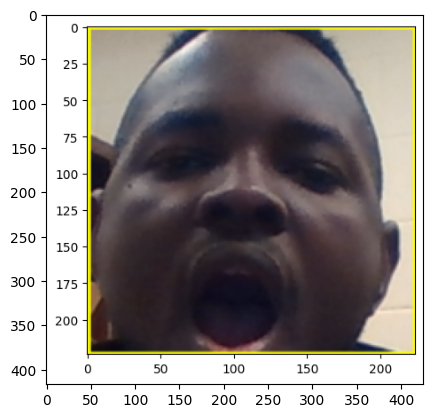

[0.0999373  0.00881933 0.05331181 0.19363905 0.00632275 0.00758745
 0.07134742 0.02053927 0.53849566]
8


In [26]:
img1 = cv2.imread("C:/Users/research/Desktop/btest/download (7).png")
plt.imshow(img1)
plt.show()
final_img = cv2.resize(img1, (224, 224))
final_img = np.expand_dims(final_img,axis =0) #adding fourth dimension
final_img = final_img/255.0 #normalizing
new_modelp = load_model("my_mthesis_model_30ep.h5")
Predictions = new_modelp.predict(final_img)
print(Predictions[0])
print(np.argmax(Predictions))

In [6]:
import cv2

new_model = tf.keras.models.load_model('my_mthesis_model_31ep.h5')

path = 'haarcascade_frontalface_default.xml'
font_scale = 1.5
font = cv2.FONT_HERSHEY_PLAIN

#set rectangle background
rectangle_bgr = (255, 255, 255)

img = np.zeros((500, 500))

text = "Somw text in a box"

(text_width, text_height) = cv2.getTextSize(text, font, fontScale=font_scale, thickness=1)[0]

text_offset_x = 10
text_offset_y = img.shape[0] - 25

box_coords = ((text_offset_x, text_offset_y), (text_offset_x + text_width + 2, text_offset_y - text_height - 2))
cv2.rectangle(img, box_coords[0], box_coords[1], rectangle_bgr, cv2.FILLED)
cv2.putText(img, text, (text_offset_x, text_offset_y), font, fontScale=font_scale, color=(0,0,0), thickness = 1)


cap = cv2.VideoCapture(1)

if not cap.isOpened():
    cap = cv2.VideoCapture(0)
if not cap.isOpened():
    raise IOError("Cannot open Webcam")
    
    
while True:
    ret, frame = cap.read()
    faceCascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    faces = faceCascade.detectMultiScale(gray,1.1,4)
    
    for x,y,w,h in faces:
        roi_gray = gray[y:y+h, x:x+w]
        roi_color = frame[y:y+h, x:x+w]
        cv2.rectangle(frame, (x, y), (x+w, y+h), (255, 0, 0), 2)
        facess = faceCascade.detectMultiScale(roi_gray)
        if len(facess) == 0:
            print("No face detected")
        else:
            for(ex, ey, ew, eh) in facess:
                face_roi = roi_color[ey: ey+eh, ex: ex+ew] #cropping the facee
                
    final_image = cv2.resize(face_roi, (224,224))
    final_image = np.expand_dims(final_image, axis =0)
    final_image = final_image/255.0
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    
    predictions = new_model.predict(final_image)
    
    font_scale = 1.5
    font = cv2.FONT_HERSHEY_PLAIN
    
    if (np.argmax(predictions)==0):
        status = "Angry"
        
        x1,y1,w1,h1 = 0,0,175,75
        cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
        #text
        cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
        cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
        
    elif (np.argmax(predictions)==1):
        status = "Contempt"
        
        x1,y1,w1,h1 = 0,0,175,75
        cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
        #text
        cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
        cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
    elif (np.argmax(predictions)==2):
        status = "Disgust"
        
        x1,y1,w1,h1 = 0,0,175,75
        cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
        #text
        cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
        cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
    elif (np.argmax(predictions)==3):
        status = "Fear"
        
        x1,y1,w1,h1 = 0,0,175,75
        cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
        #text
        cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
        cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
    elif (np.argmax(predictions)==4):
        status = "Happy"
        
        x1,y1,w1,h1 = 0,0,175,75
        cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
        #text
        cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
        cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
    elif (np.argmax(predictions)==5):
        status = "Sad"
        
        x1,y1,w1,h1 = 0,0,175,75
        cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
        #text
        cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
        cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
    elif (np.argmax(predictions)==7):
        status = "Pain"
        
        x1,y1,w1,h1 = 0,0,175,75
        cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
        #text
        cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
        cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
    elif (np.argmax(predictions)==8):
        status = "Tired"
        
        x1,y1,w1,h1 = 0,0,175,75
        cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
        #text
        cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
        cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
    else:
        status = "Angry"
        
        x1,y1,w1,h1 = 0,0,175,75
        cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
        #text
        cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
        cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,255,0))
    
    
    

NameError: name 'face_roi' is not defined

In [2]:
import cv2

new_model = tf.keras.models.load_model('amodel_7ep.h5')

path = 'haarcascade_frontalface_default.xml'
font_scale = 1.5
font = cv2.FONT_HERSHEY_PLAIN

#set rectangle background
rectangle_bgr = (255, 255, 255)

img = np.zeros((500, 500))

text = "Somw text in a box"

(text_width, text_height) = cv2.getTextSize(text, font, fontScale=font_scale, thickness=1)[0]

text_offset_x = 10
text_offset_y = img.shape[0] - 25

box_coords = ((text_offset_x, text_offset_y), (text_offset_x + text_width + 2, text_offset_y - text_height - 2))
cv2.rectangle(img, box_coords[0], box_coords[1], rectangle_bgr, cv2.FILLED)
cv2.putText(img, text, (text_offset_x, text_offset_y), font, fontScale=font_scale, color=(0,0,0), thickness = 1)


cap = cv2.VideoCapture(1)

if not cap.isOpened():
    cap = cv2.VideoCapture(0)
if not cap.isOpened():
    raise IOError("Cannot open Webcam")
    
    
while True:
    ret, frame = cap.read()
    faceCascade =  cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    faces = faceCascade.detectMultiScale(gray,1.1,4)
    
    for x,y,w,h in faces:
        roi_gray = gray[y:y+h, x:x+w]
        roi_color = frame[y:y+h, x:x+w]
        cv2.rectangle(frame, (x, y), (x+w, y+h), (255, 0, 0), 2)
        facess = faceCascade.detectMultiScale(roi_gray)
        if len(facess) == 0:
            print("No face detected")
        else:
            for(ex, ey, ew, eh) in facess:
                face_roi = roi_color[ey: ey+eh, ex: ex+ew] #cropping the facee
                
                final_image = cv2.resize(face_roi, (48,48))
                final_image = cv2.resize(final_image, (224,224))
                final_image = np.expand_dims(final_image, axis =0)
                final_image = final_image/255.0
    
                font = cv2.FONT_HERSHEY_SIMPLEX
    
                predictions = new_model.predict(final_image)
                
                font_scale = 1.5
                font = cv2.FONT_HERSHEY_PLAIN
                
                if (np.argmax(predictions)==0):
                    status = "Angry"
        
                    x1,y1,w1,h1 = 0,0,175,75
                    cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
                    #text
                    cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
                    cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
                    cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
                        
        
                elif (np.argmax(predictions)==1):
                    status = "Surprise"
        
                    x1,y1,w1,h1 = 0,0,175,75
                    cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
                    #text
                    cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
                    cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
                    cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
                elif (np.argmax(predictions)==2):
                    status = "Disgust"
        
                    x1,y1,w1,h1 = 0,0,175,75
                    cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
                    #text
                    cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
                    cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
                    cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
                elif (np.argmax(predictions)==3):
                    status = "Fear"
        
                    x1,y1,w1,h1 = 0,0,175,75
                    cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
                    #text
                    cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
                    cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
                    cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
                elif (np.argmax(predictions)==4):
                    status = "Happy"
        
                    x1,y1,w1,h1 = 0,0,175,75
                    cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
                    #text
                    cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
                    cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
                    cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
                elif (np.argmax(predictions)==5):
                    status = "Sad"
        
                    x1,y1,w1,h1 = 0,0,175,75
                    cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
                    #text
                    cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
                    cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
                    cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
                elif (np.argmax(predictions)==7):
                    status = "Pain"
        
                    x1,y1,w1,h1 = 0,0,175,75
                    cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
                    #text
                    cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
                    cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
                    cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
                elif (np.argmax(predictions)==8):
                    status = "Tired"
        
                    x1,y1,w1,h1 = 0,0,175,75
                    cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
                    #text
                    cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
                    cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
                    cv2.rectangle(frame, (x, y), (x+w, y+h), (0,0,255))
                else:
                    status = "Neutral"
        
                    x1,y1,w1,h1 = 0,0,175,75
                    cv2.rectangle(frame, (x1,x1), (x1 + w1, y1 + h1), (0,0,0), -1)
                    #text
                    cv2.putText(frame, status, (x1 + int(w1/10), y1 + int(h1/2)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,255), 2)
        
                    cv2.putText(frame, status, (100, 150), font, 3, (0,0,255), 2, cv2.LINE_4)
        
                    cv2.rectangle(frame, (x, y), (x+w, y+h), (0,255,0))
            
    #Display the resulting frame
    cv2.imshow('frame', frame)
    if cv2.waitKey(20) & 0xFF == ord('q'):
        break
    

No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detect

No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detect

No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detect

No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detected
No face detect

KeyboardInterrupt: 